- **Name - Aditya Jain**

- **Batch No. - DS2310**

- **Assingment - Rainfal  Weather Forecasting**

In [1]:
# import required library
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings # filter warnings
warnings.filterwarnings('ignore')

In [2]:
# import data
data = pd.read_csv("https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv")
data.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [3]:
print('No. of rows',data.shape[0])
print('No. of columns',data.shape[1])

No. of rows 8425
No. of columns 23


In [4]:
data.columns.to_series().groupby(data.dtypes).groups

{float64: ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm'], object: ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']}

**Observation-:**

- There are 8425 rows and 23 columns are present in the dataset.
- And here we predict RainToday and RainTomorrow

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

# Statistical Analysis

**Since dataset is large, let check for any entry which is repeated or duplicate in dataset.**

**Data Integrity Check**

In [6]:
data.isin([' ','NA','-']).sum().any()

False

In [7]:
data.isin(['?']).sum().any()

False

**Datasets does not contains any duplicate entry. So yes to go!!**

# Missing Value Check

In [8]:
Missing_val = data.isnull().sum().sort_values(ascending = False)
percentage_missing_val = (Missing_val/len(data))*100
print(pd.concat([Missing_val,percentage_missing_val], axis = 1, keys=['Missing_values','%Missing values']))

               Missing_values  %Missing values
Sunshine                 3994        47.406528
Evaporation              3512        41.685460
Cloud3pm                 2455        29.139466
Cloud9am                 2421        28.735905
Pressure3pm              1312        15.572700
Pressure9am              1309        15.537092
WindGustDir               991        11.762611
WindGustSpeed             991        11.762611
WindDir9am                829         9.839763
WindDir3pm                308         3.655786
RainToday                 240         2.848665
Rainfall                  240         2.848665
RainTomorrow              239         2.836795
WindSpeed3pm              107         1.270030
Humidity3pm               102         1.210682
Temp3pm                    96         1.139466
WindSpeed9am               76         0.902077
MinTemp                    75         0.890208
MaxTemp                    60         0.712166
Humidity9am                59         0.700297
Temp9am      

- Sunshine, Evaporation, Cloud3pm, Cloud9am, Pressure3pm, Pressure9am, WindGustDir, WindGustSpeed, WindDir9am,Temp9am, WindDir3pm, RainToday, Rainfall, RainTomorrow, WindSpeed3pm, Humity3pm, Temp3pm, WindSpeed9am, MinTem, MaxTemp, Humidity9am.
- These Columns have contain missing values.

# Missing value imputation

In [9]:
# imputation missing values with median and mean for Numerical features
data['MinTemp']= data['MinTemp'].fillna(data['MinTemp'].median())
data['MaxTemp']= data['MaxTemp'].fillna(data['MaxTemp'].median())
data['Rainfall']= data['Rainfall'].fillna(data['Rainfall'].median())
data['Evaporation']= data['Evaporation'].fillna(data['Evaporation'].median())
data['Sunshine']= data['Sunshine'].fillna(data['Sunshine'].median())
data['WindGustSpeed']= data['WindGustSpeed'].fillna(data['WindGustSpeed'].mean())
data['WindSpeed9am']= data['WindSpeed9am'].fillna(data['WindSpeed9am'].mean())
data['WindSpeed3pm']= data['WindSpeed3pm'].fillna(data['WindSpeed3pm'].mean())
data['Humidity9am']= data['Humidity9am'].fillna(data['Humidity9am'].mean())
data['Humidity3pm']= data['Humidity3pm'].fillna(data['Humidity3pm'].mean())
data['Pressure9am']= data['Pressure9am'].fillna(data['Pressure9am'].mean())
data['Pressure3pm']= data['Pressure3pm'].fillna(data['Pressure3pm'].mean())
data['Cloud9am']= data['Cloud9am'].fillna(data['Cloud9am'].mean())
data['Cloud3pm']= data['Cloud3pm'].fillna(data['Cloud3pm'].mean())
data['Temp9am']= data['Temp9am'].fillna(data['Temp9am'].mean())
data['Temp3pm']= data['Temp3pm'].fillna(data['Temp3pm'].mean())

# imputation missing values with mode for Categorial features
data['WindGustDir']= data['WindGustDir'].fillna(data['WindGustDir'].mode()[0])
data['WindDir9am']= data['WindDir9am'].fillna(data['WindDir9am'].mode()[0])
data['WindDir3pm']= data['WindDir3pm'].fillna(data['WindDir3pm'].mode()[0])
data['RainToday']= data['RainToday'].fillna(data['RainToday'].mode()[0])
data['RainTomorrow']= data['RainTomorrow'].fillna(data['RainTomorrow'].mode()[0])

# Check Missing Value After Imputation

In [10]:
Missing_val = data.isnull().sum().sort_values(ascending = False)
percentage_missing_val = (Missing_val/len(data))*100
print(pd.concat([Missing_val,percentage_missing_val], axis = 1, keys=['Missing_values','%Missing values']))

               Missing_values  %Missing values
Date                        0              0.0
WindSpeed3pm                0              0.0
RainToday                   0              0.0
Temp3pm                     0              0.0
Temp9am                     0              0.0
Cloud3pm                    0              0.0
Cloud9am                    0              0.0
Pressure3pm                 0              0.0
Pressure9am                 0              0.0
Humidity3pm                 0              0.0
Humidity9am                 0              0.0
WindSpeed9am                0              0.0
Location                    0              0.0
WindDir3pm                  0              0.0
WindDir9am                  0              0.0
WindGustSpeed               0              0.0
WindGustDir                 0              0.0
Sunshine                    0              0.0
Evaporation                 0              0.0
Rainfall                    0              0.0
MaxTemp      

In [11]:
data.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

<Axes: >

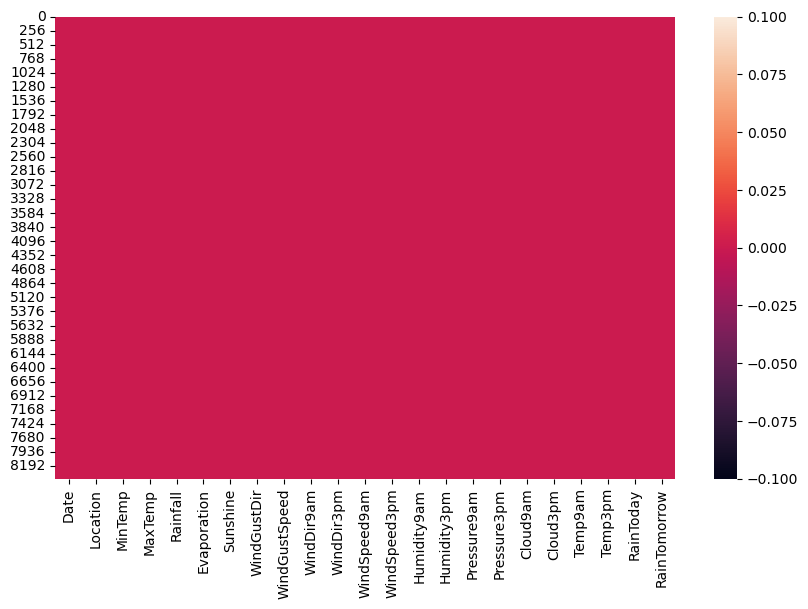

In [12]:
plt.figure(figsize=(10,6))
sns.heatmap(data.isnull())

**Now, No missing Value Present**

In [13]:
data.shape

(8425, 23)

In [14]:
# we will remove some duplicate data those present in the datasets
data=data.drop_duplicates()
data.shape

(6762, 23)

We can see that duplicated values has been dropped as earlier rows consist of 8425 then after removing duplicates rows will be 6762.

# Statistical Matrix

In [15]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,6762.0,13.111121,5.540700,-2.0,9.0,13.200000,17.4,28.5
MaxTemp,6762.0,24.091615,6.130557,8.2,19.6,23.400000,28.4,45.5
Rainfall,6762.0,2.723410,10.490138,0.0,0.0,0.000000,0.8,371.0
Evaporation,6762.0,4.998980,3.361770,0.0,4.0,4.600000,5.0,145.0
Sunshine,6762.0,8.278098,2.763362,0.0,8.7,8.700000,9.2,13.9
WindGustSpeed,6762.0,39.144388,13.382876,7.0,30.0,39.000000,46.0,107.0
WindSpeed9am,6762.0,12.792133,9.788112,0.0,6.0,11.000000,19.0,63.0
WindSpeed3pm,6762.0,17.585384,9.549341,0.0,11.0,17.000000,24.0,83.0
Humidity9am,6762.0,67.509082,17.182723,10.0,56.0,68.000000,80.0,100.0
Humidity3pm,6762.0,50.478258,18.498573,6.0,38.0,50.000000,62.0,99.0


In [16]:
for i in data.columns:
    print(i)
    print(data[i].value_counts())
    print('='*100)

Date
2011-02-11    4
2011-02-18    4
2011-03-18    4
2011-03-19    4
2011-03-20    4
             ..
2016-11-03    1
2016-11-02    1
2016-11-01    1
2016-10-31    1
2013-06-08    1
Name: Date, Length: 3004, dtype: int64
Location
PerthAirport    1204
Albury           907
Newcastle        822
Melbourne        811
Williamtown      615
CoffsHarbour     611
Brisbane         579
Penrith          482
Darwin           250
Wollongong       237
Adelaide         205
Uluru             39
Name: Location, dtype: int64
MinTemp
13.3    118
13.2     58
12.0     57
14.8     53
12.7     53
       ... 
26.6      1
28.0      1
26.9      1
1.4       1
26.0      1
Name: MinTemp, Length: 285, dtype: int64
MaxTemp
23.3    99
19.0    66
19.8    62
23.8    54
22.3    54
        ..
38.9     1
10.3     1
9.4      1
42.5     1
43.5     1
Name: MaxTemp, Length: 331, dtype: int64
Rainfall
0.0      4472
0.2       321
0.4       144
0.6        87
1.2        69
         ... 
73.8        1
23.8        1
61.2        1
128.

**Observation-:**

- RainTomorrow Column which is a target variable is imbalanced.
- Encoding Techniques is to be used on many categorial columns later.

In [17]:
# Checking Wheather the target variable contains any space.
data.loc[data['RainTomorrow']==" "]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow


So, no space is present in the dataset

In [18]:
# Now we will convert date from object type to date type and then separate day, month and year.
data['Date']=pd.to_datetime(data['Date'])
data['Day']= data['Date'].dt.day
data['Month']= data['Date'].dt.month
data['Year']= data['Date'].dt.year

In [19]:
# Now,, we will drop date column because we have already got, Day, Month, Year
data.drop("Date", axis = 1, inplace=True)

# EDA

**Start EDA by analysing our target variable first.**

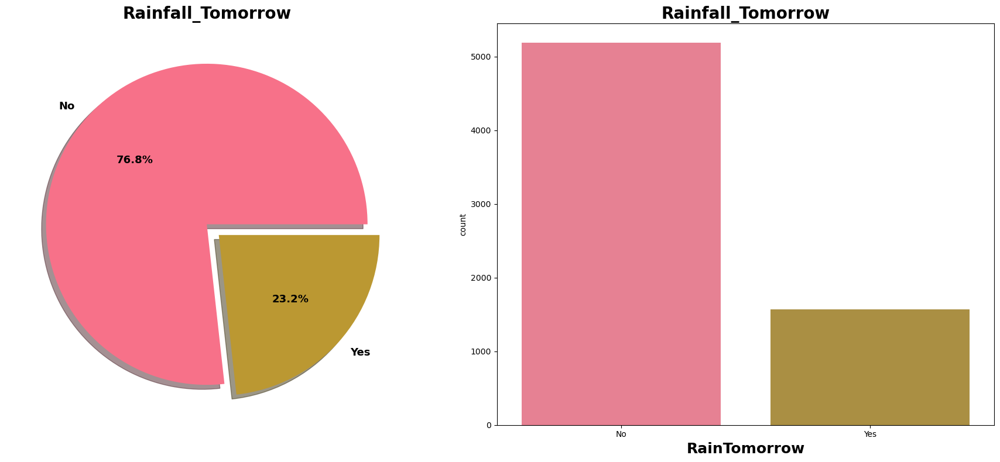

In [20]:
plt.rcParams["figure.autolayout"]=True
sns.set_palette('husl')
f, ax=plt.subplots(1,2,figsize=(18,8))
data['RainTomorrow'].value_counts().plot.pie(explode=[0,0.1],autopct='%2.1f%%',textprops = {'fontweight':'bold','fontsize':13}, ax = ax[0],shadow=True)
ax[0].set_title('Rainfall_Tomorrow', fontsize =20, fontweight='bold')
ax[0].set_ylabel('')
sns.countplot(x='RainTomorrow', data=data, ax=ax[1])
ax[1].set_title("Rainfall_Tomorrow", fontsize=20, fontweight='bold')
ax[1].set_xlabel("RainTomorrow", fontsize=18, fontweight='bold')
plt.show()

**Observation-:**

- Out of all rain fall for tomorrow around 76.8% will be No.
- RainTomorrow is our target variable to be predict. From countplot we can say dataset is imbalanced in nature.

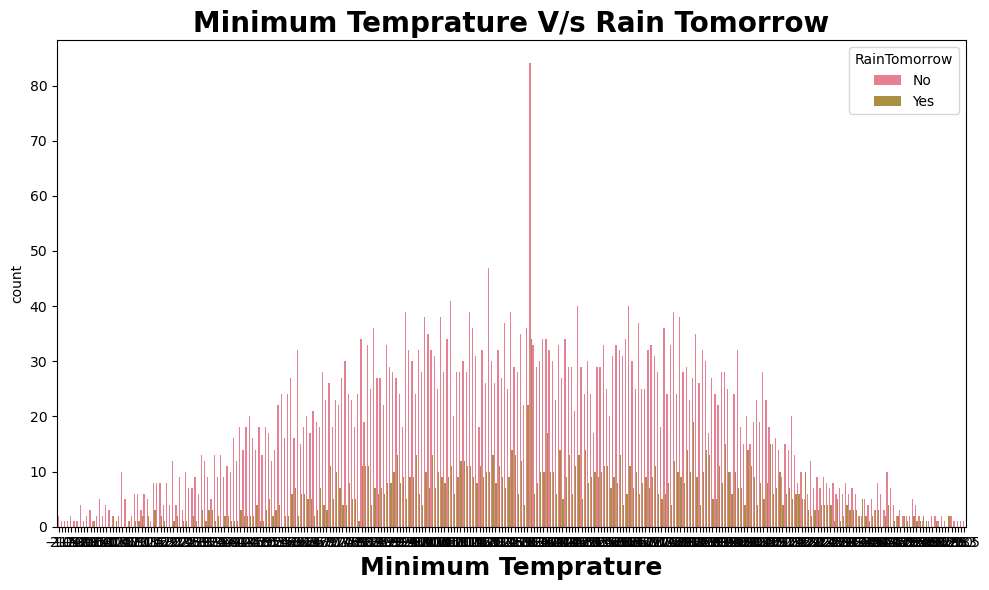

In [21]:
plt.figure(figsize = (10,6))
sns.countplot(x = data.MinTemp, hue = data.RainTomorrow)
plt.xlabel("Minimum Temprature", fontsize = 18,fontweight = 'bold')
plt.title("Minimum Temprature V/s Rain Tomorrow", fontsize = 20, fontweight = 'bold')
plt.show()

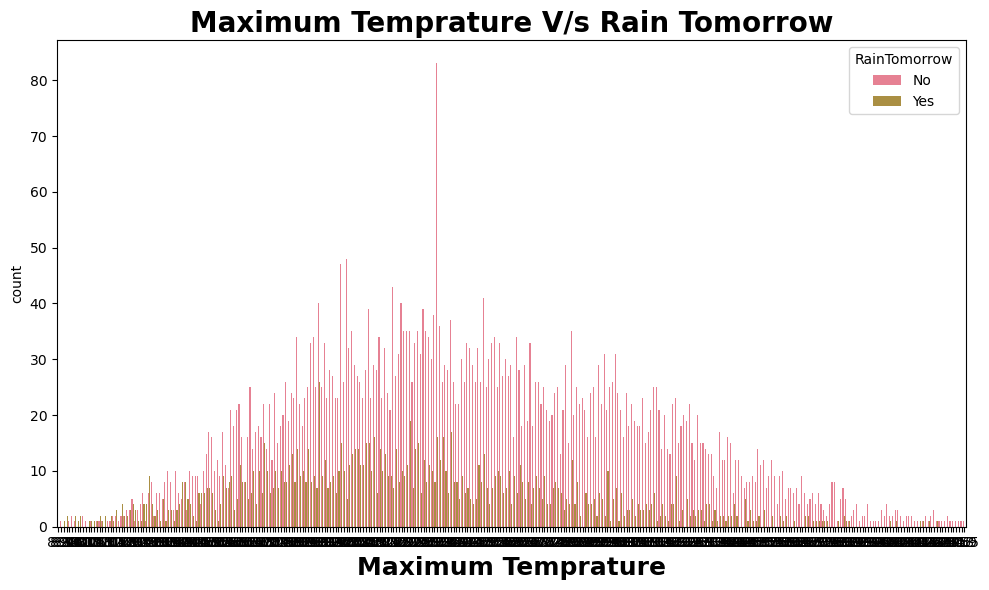

In [22]:
plt.figure(figsize = (10,6))
sns.countplot(x = data.MaxTemp, hue = data.RainTomorrow)
plt.xlabel("Maximum Temprature", fontsize = 18,fontweight = 'bold')
plt.title("Maximum Temprature V/s Rain Tomorrow", fontsize = 20, fontweight = 'bold')
plt.show()

# We will plot all categorial columns

Value Counts -: PerthAirport    1204
Albury           907
Newcastle        822
Melbourne        811
Williamtown      615
CoffsHarbour     611
Brisbane         579
Penrith          482
Darwin           250
Wollongong       237
Adelaide         205
Uluru             39
Name: Location, dtype: int64


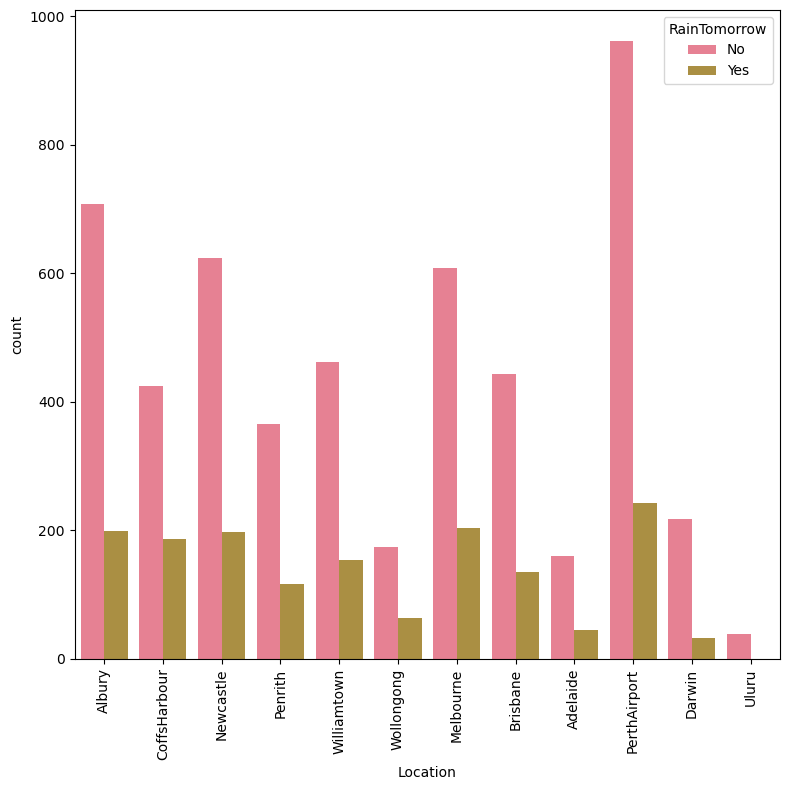

In [23]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['Location'].value_counts())
sns.countplot(x='Location',hue='RainTomorrow',data=data)
plt.xticks(rotation=90)
plt.show()

**Observation-:**

- Maximum count is of PerthAirport and probability of maximum rainfall for tomorrow seems to be same.
- Least count rainfall for tomorrow don't seem seem for this place.

Value Counts -: N      1401
E       518
SW      465
W       434
WSW     420
WNW     398
SSE     390
S       376
SE      370
ENE     357
NE      300
SSW     299
NW      296
NNE     287
ESE     267
NNW     184
Name: WindGustDir, dtype: int64


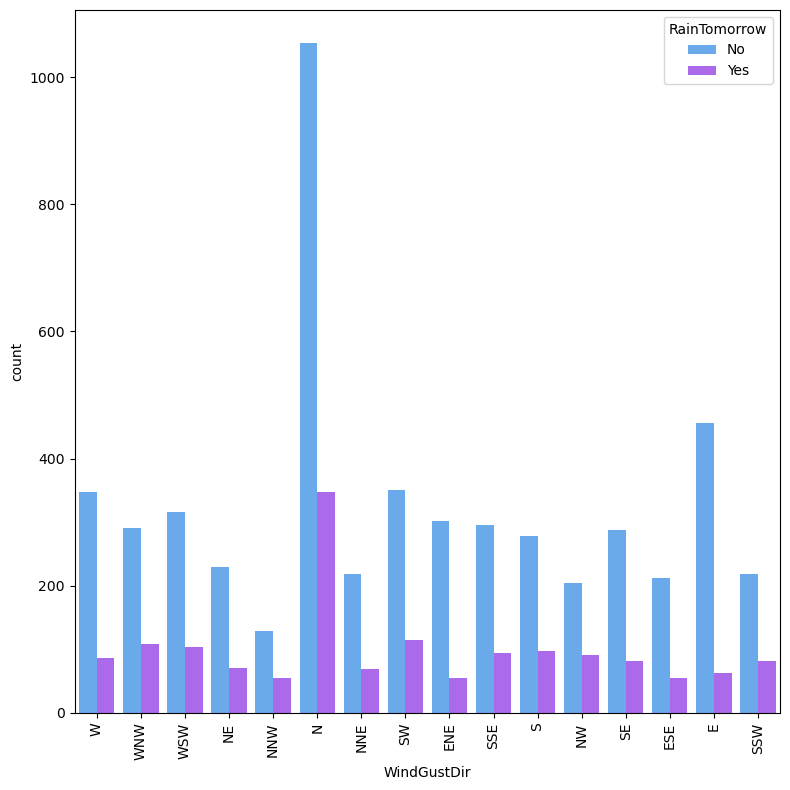

In [24]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['WindGustDir'].value_counts())
sns.countplot(x='WindGustDir',hue='RainTomorrow',data=data,palette='cool')
plt.xticks(rotation=90)
plt.show()

**Observation-:**

The maximum count of 'N' direction and the probability to rain tomorrow is also from 'N' direction and the  least of both is from NNW.

Value Counts -: N      1403
SW      590
NW      463
SE      439
ENE     397
WSW     394
SSW     368
NE      364
E       338
NNE     337
S       324
WNW     301
SSE     300
W       299
ESE     229
NNW     216
Name: WindDir9am, dtype: int64


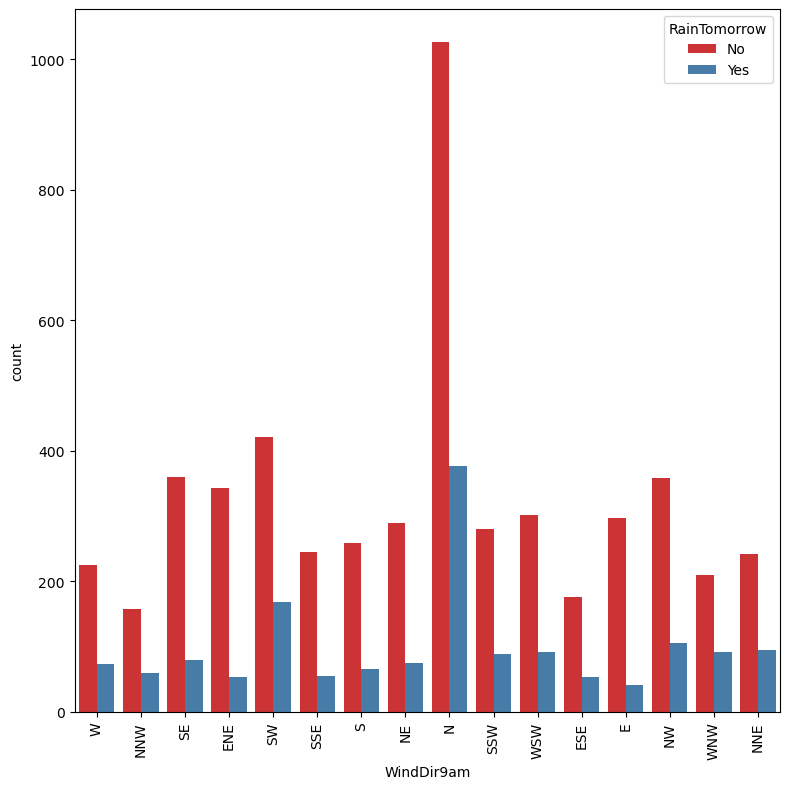

In [25]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['WindDir9am'].value_counts())
sns.countplot(x='WindDir9am',hue='RainTomorrow',data=data,palette='Set1')
plt.xticks(rotation=90)
plt.show()

**Observation-:**

The maximum count of 'N' direction and the probabality to rain tomorrow is also from 'N' direction and the least of both is from NNW.

Value Counts -: SE     971
WSW    499
S      493
NE     480
SW     428
SSE    421
NW     400
W      399
E      392
WNW    389
ESE    363
N      354
ENE    348
NNE    305
SSW    277
NNW    243
Name: WindDir3pm, dtype: int64


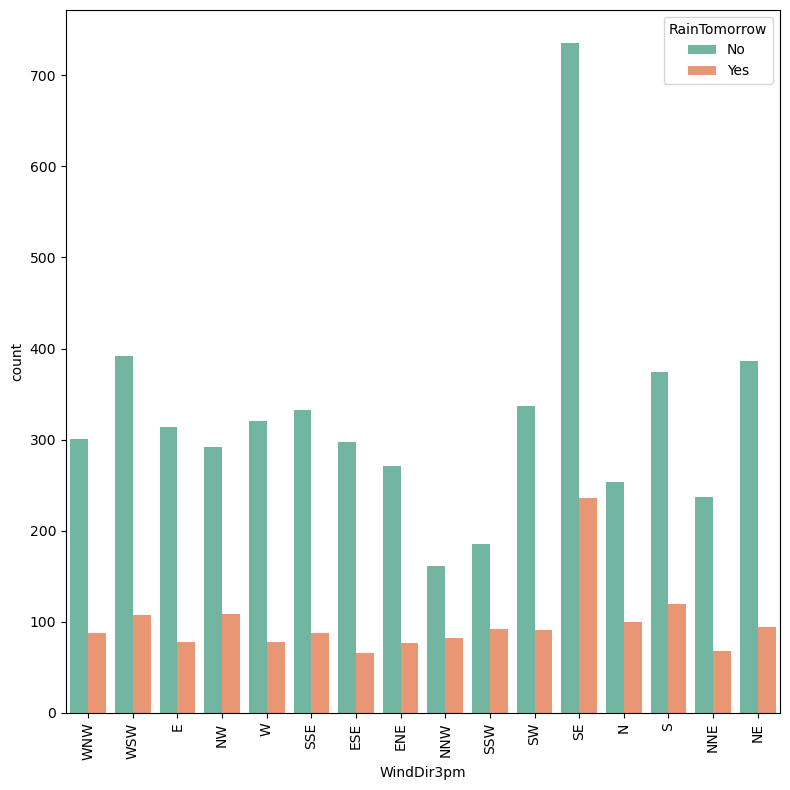

In [26]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['WindDir3pm'].value_counts())
sns.countplot(x='WindDir3pm',hue='RainTomorrow',data=data,palette='Set2')
plt.xticks(rotation=90)
plt.show()

**Observation-:**

The maximum count of 'SE' direction and the probabality to rain tomorrow is also from 'SE' direction and the least of both is from NNW.

Value Counts -: No     5190
Yes    1572
Name: RainToday, dtype: int64


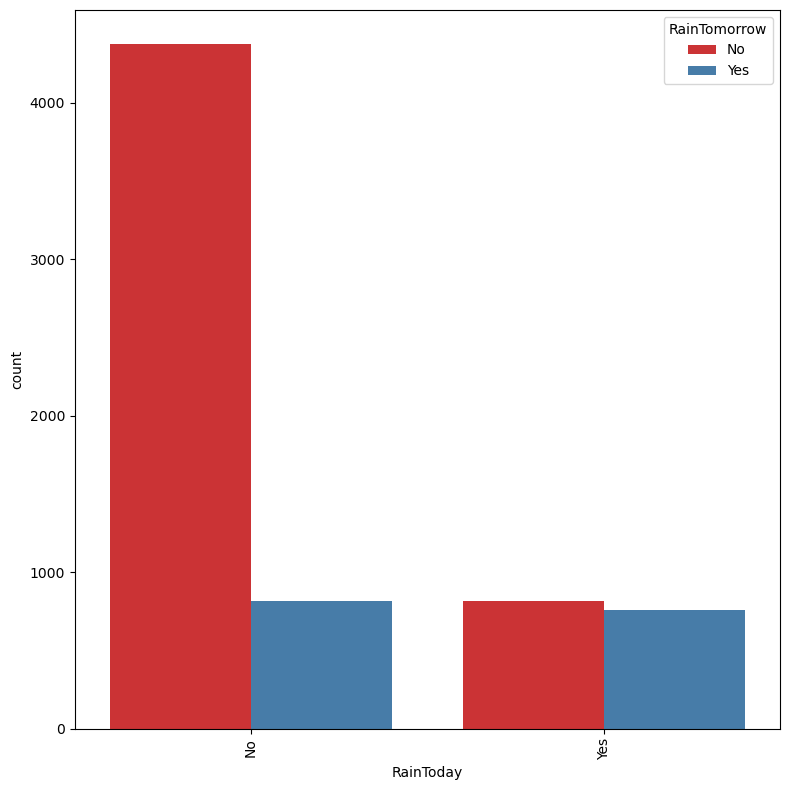

In [27]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['RainToday'].value_counts())
sns.countplot(x='RainToday',hue='RainTomorrow',data=data,palette='Set1')
plt.xticks(rotation=90)
plt.show()

**Observation-:**

When there is a chance of rain today, so there can be equal chance of rain tomorrow atleast 90%.

Value Counts -: No     5190
Yes    1572
Name: RainToday, dtype: int64


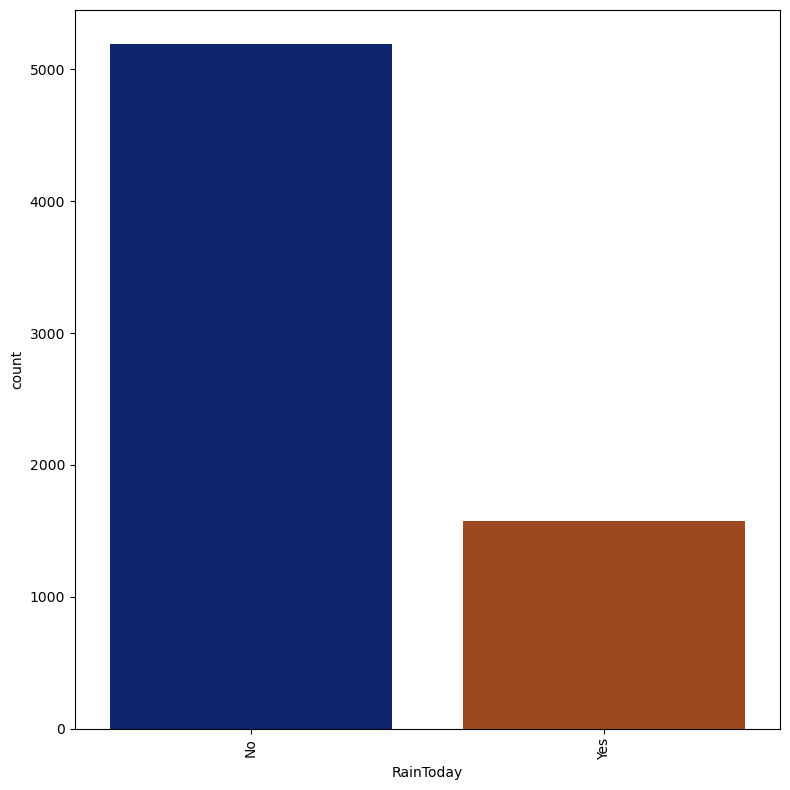

In [28]:
plt.figure(figsize=(8,8))
print('Value Counts -:', data['RainToday'].value_counts())
sns.countplot(x='RainToday',data=data,palette='dark')
plt.xticks(rotation=90)
plt.show()

**The max probability of rain is No as per the count.**

# We will plot Numerical Columns

In [29]:
Numerical =[]
for i in data.dtypes.index:
    if data.dtypes[i]!='object':
        Numerical.append(i)
print("Numerical Columns are:\n",Numerical)

Numerical Columns are:
 ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Day', 'Month', 'Year']


# These are the Numerical Columns ahead

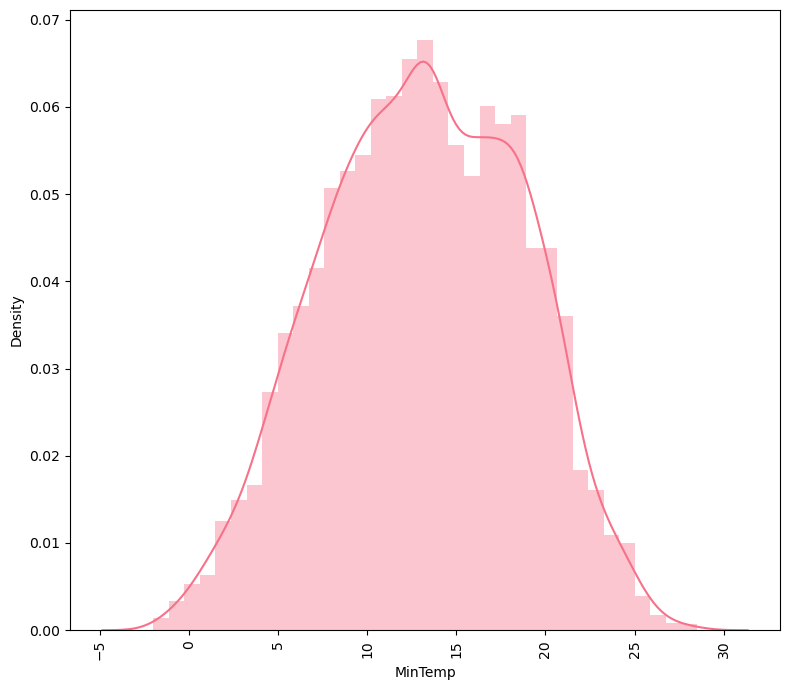

In [30]:
plt.figure(figsize=(8,7))
sns.distplot(data['MinTemp'])
plt.xticks(rotation=90)
plt.show()

In [31]:
data['MinTemp'].mean()

13.11112097012718

**Observation-:**

- As by the graph and by the mean command also, we see that the average MinTemp is 13.

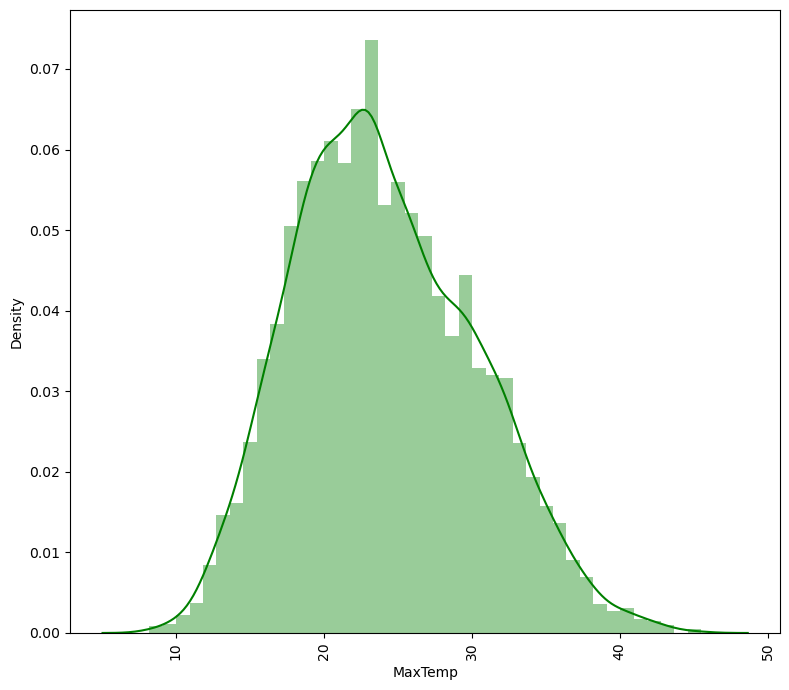

Mean -: 24.091614906832298


In [32]:
plt.figure(figsize=(8,7))
sns.distplot(data['MaxTemp'],color='g')
plt.xticks(rotation=90)
plt.show()
print('Mean -:',data['MaxTemp'].mean())

**Observation-:**

- As by the graph and by the mean command also, we can see that the average MaxTemp is 24

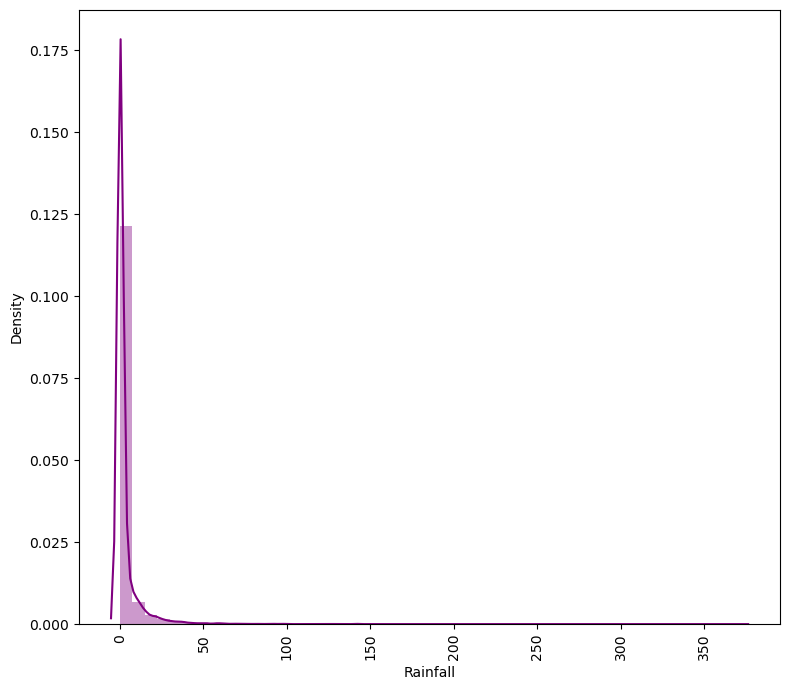

Mean -: 2.7234102336586803


In [33]:
plt.figure(figsize=(8,7))
sns.distplot(data['Rainfall'],color='purple')
plt.xticks(rotation=90)
plt.show()
print('Mean -:',data['Rainfall'].mean())

**Observation-:**

- We have the average rainfall recorded in a day 3mm.

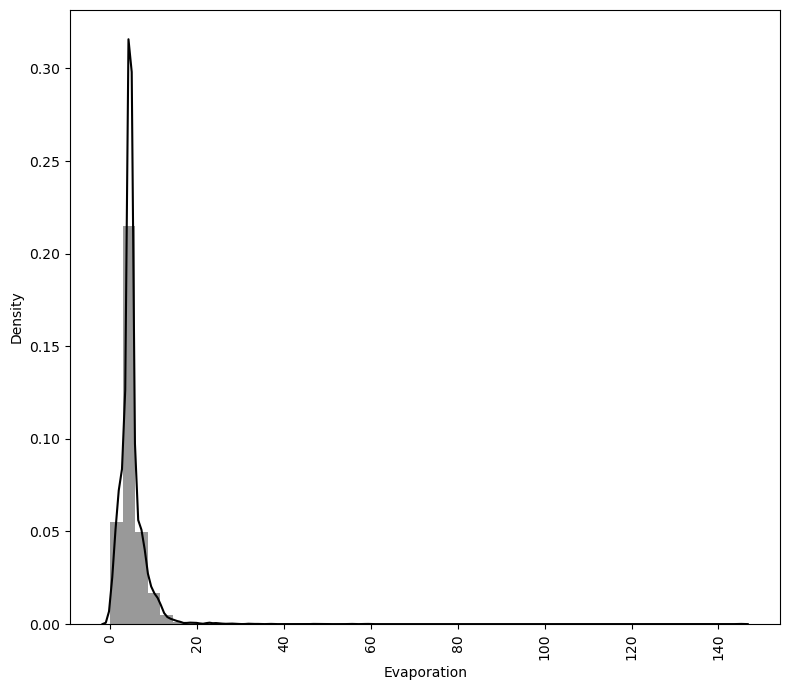

Mean -: 4.9989795918367355


In [34]:
plt.figure(figsize=(8,7))
sns.distplot(data['Evaporation'],color='black')
plt.xticks(rotation=90)
plt.show()
print('Mean -:',data['Evaporation'].mean())

**Observation-:**

- Evaporation (mm) in the 24 hours to 9am in average is 5mm.

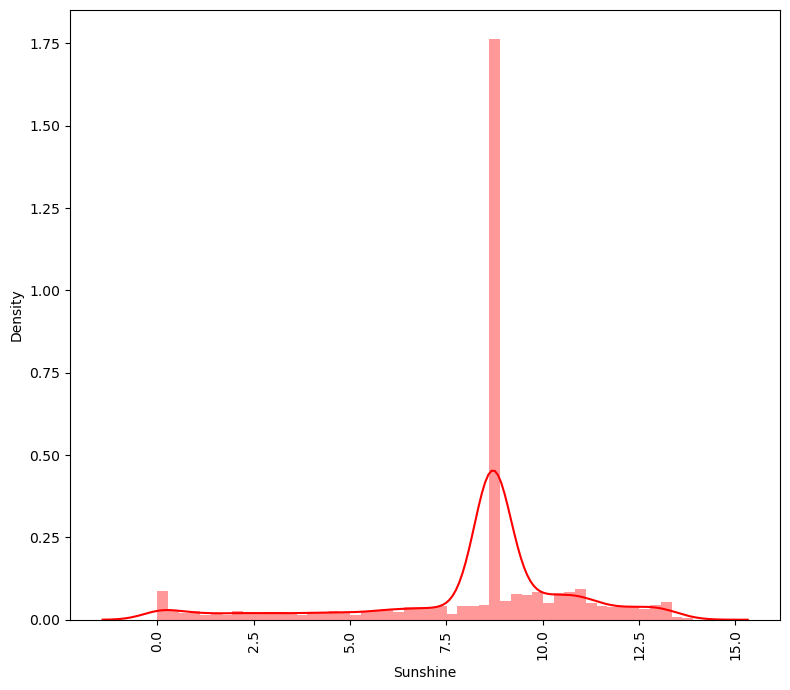

Mean -: 8.27809819580006


In [35]:
plt.figure(figsize=(8,7))
sns.distplot(data['Sunshine'],color='r')
plt.xticks(rotation=90)
plt.show()
print('Mean -:',data['Sunshine'].mean())

**Observation-:**

- The average Sunshine is a day is for approx 8.30 hrs.

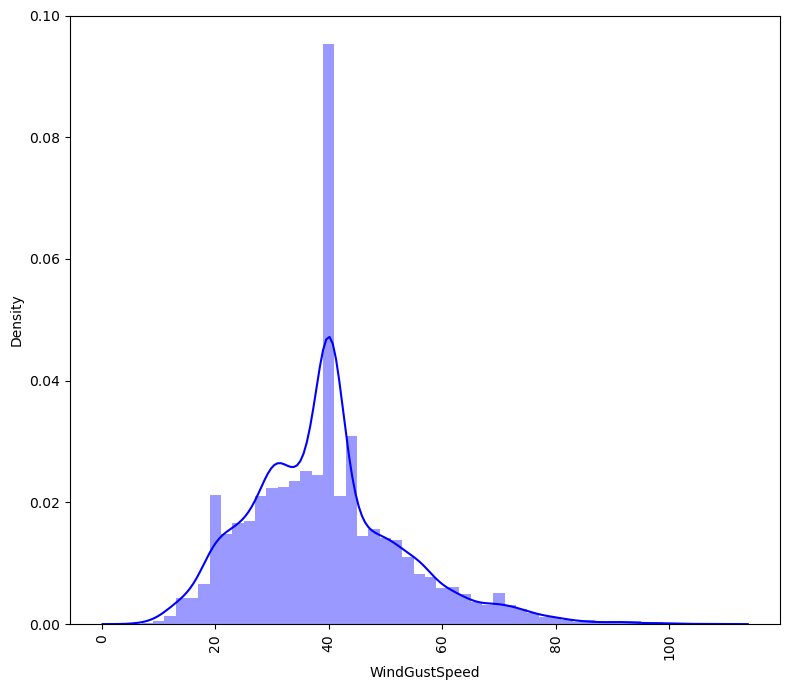

Mean -: 39.14438767751899


In [36]:
plt.figure(figsize=(8,7))
sns.distplot(data['WindGustSpeed'],color='blue')
plt.xticks(rotation=90)
plt.show()
print('Mean -:',data['WindGustSpeed'].mean())

**Observation-:**

- The direction of the strongest wind gust in the 24 hours to midnight and its average 39.

# Let us find the rainfall at diffrent location

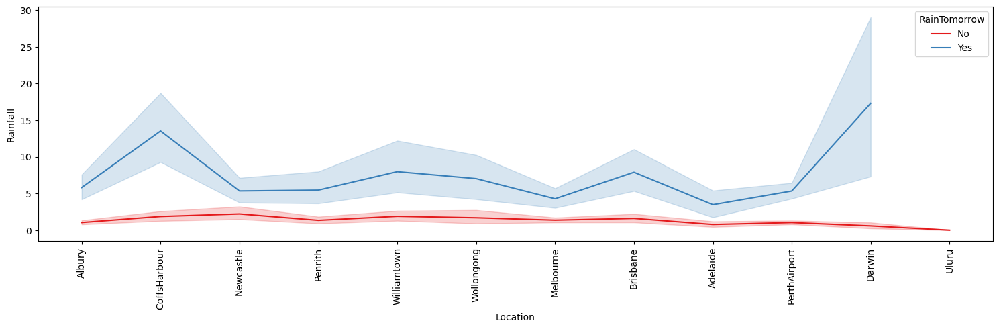

In [37]:
plt.figure (figsize=(15,5))
plt.xticks(rotation=90)
sns.lineplot(x='Location',y='Rainfall',hue='RainTomorrow',data=data,palette='Set1')
plt.show()

**Observation-:**

- Darwin and CoffsHarbour seems to having the maximum chances of rainfall tomorrow and Uluru seems to be least having the chance.

<Figure size 1500x500 with 0 Axes>

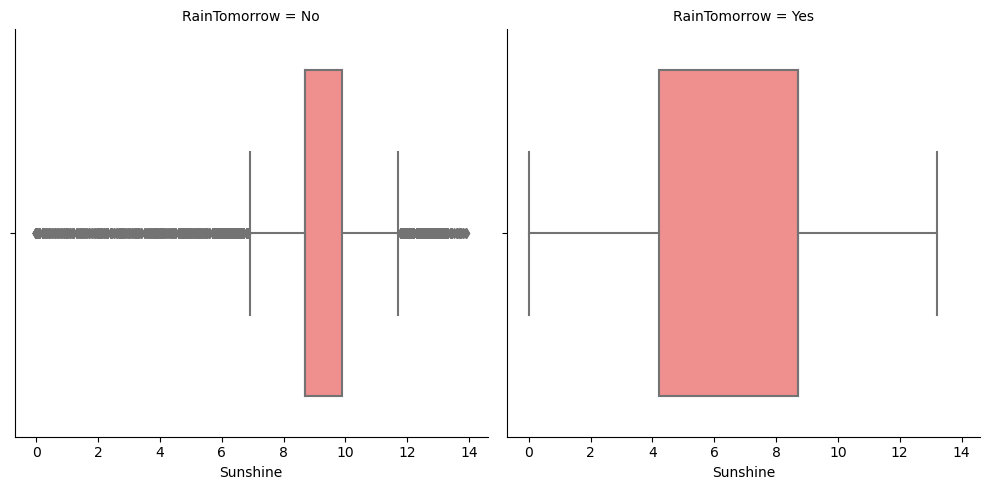

In [38]:
plt.figure (figsize=(15,5))
sns.catplot(x='Sunshine',col='RainTomorrow',data=data,kind='box',palette='spring')
plt.show()

**Observation-:**

- If we have Sunlight from 8hrs to 10+ hrs in a day tomorrow the probability of rainfall is less and if we have sunlight for 4 to 8.5 hrs chances of rain are possible tomorrow.

<Figure size 1500x500 with 0 Axes>

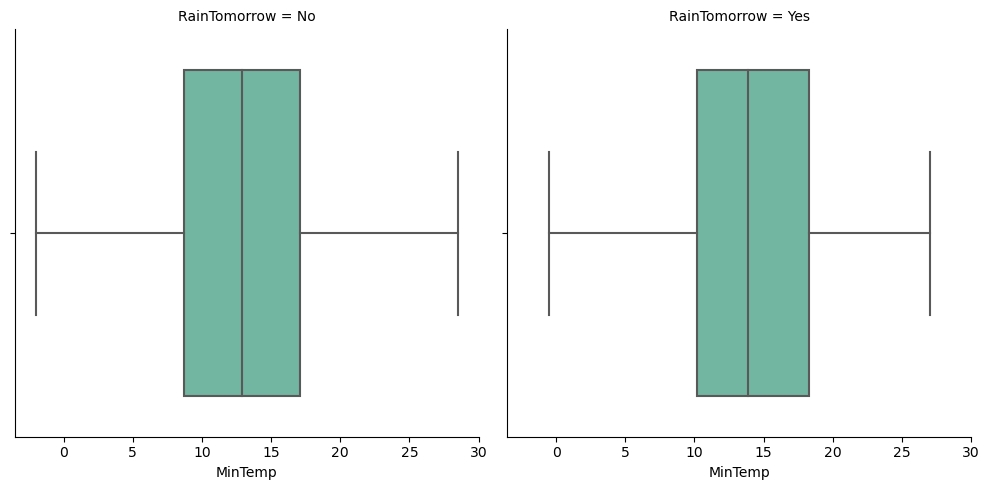

In [39]:
plt.figure (figsize=(15,5))
sns.catplot(x='MinTemp',col='RainTomorrow',data=data,kind='box',palette='Set2')
plt.show()

**Observation-:**

- When the min temp is between 10 to 19 there are possibility of rain tomorrow.

<Figure size 1500x500 with 0 Axes>

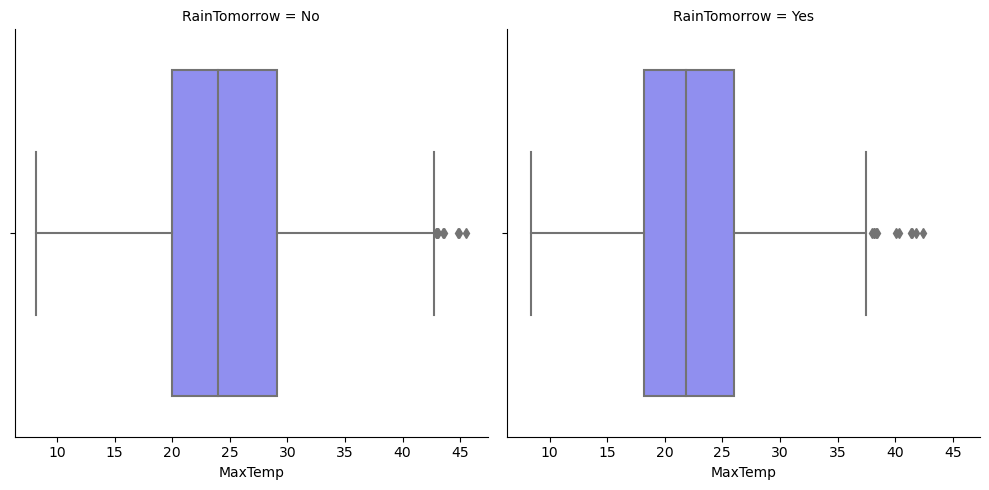

In [40]:
plt.figure (figsize=(15,5))
sns.catplot(x='MaxTemp',col='RainTomorrow',data=data,kind='box',palette='cool')
plt.show()

**Observation-:**

- When the max temp is between 18 to 27 there are possibility of rain tomorrow.

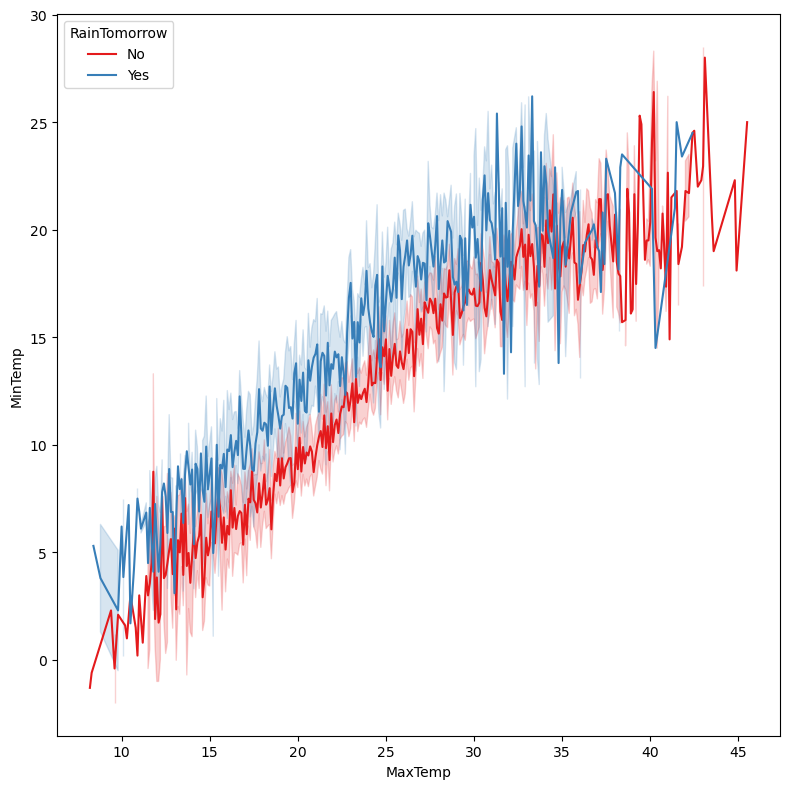

In [41]:
plt.figure (figsize=(8,8))
sns.lineplot(x='MaxTemp',y='MinTemp',hue='RainTomorrow',data=data,palette='Set1')
plt.show()

**Observation-:**

- We can see that MinTemp and MaxTemp have linear relationship to rain tomorrow column, There is slight change in Min and Max temp for the occurance of rainfall tomorrow.

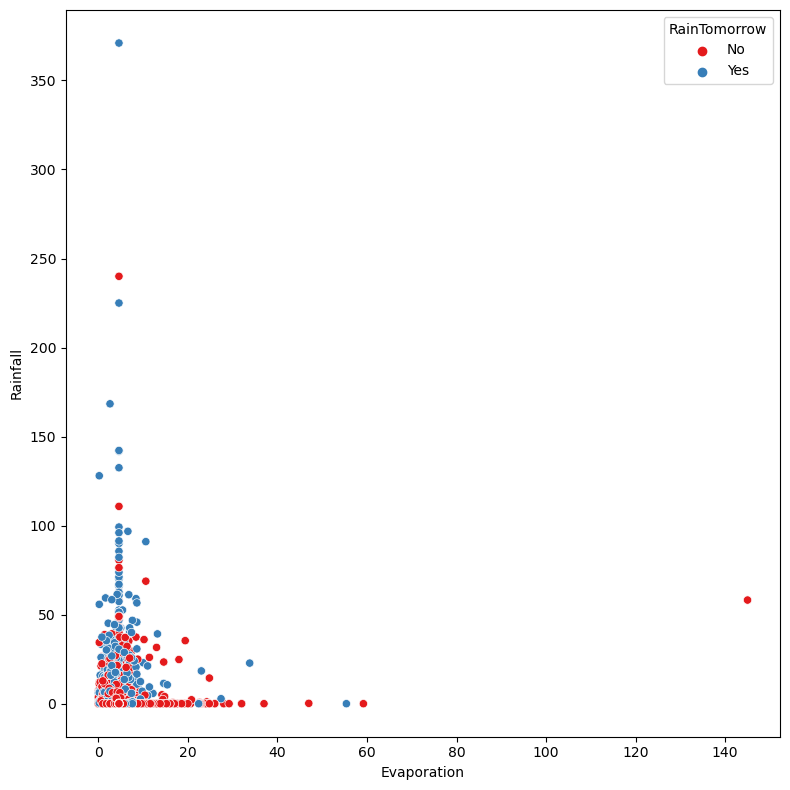

In [42]:
plt.figure (figsize=(8,8))
sns.scatterplot(x='Evaporation',y='Rainfall',hue='RainTomorrow',data=data,palette='Set1')
plt.show()

**Observation-:**

-  Till evaporation 5mm we can see that maximum rainfall and if we have 5mm evaporation tomorrow we can expect rainfall.

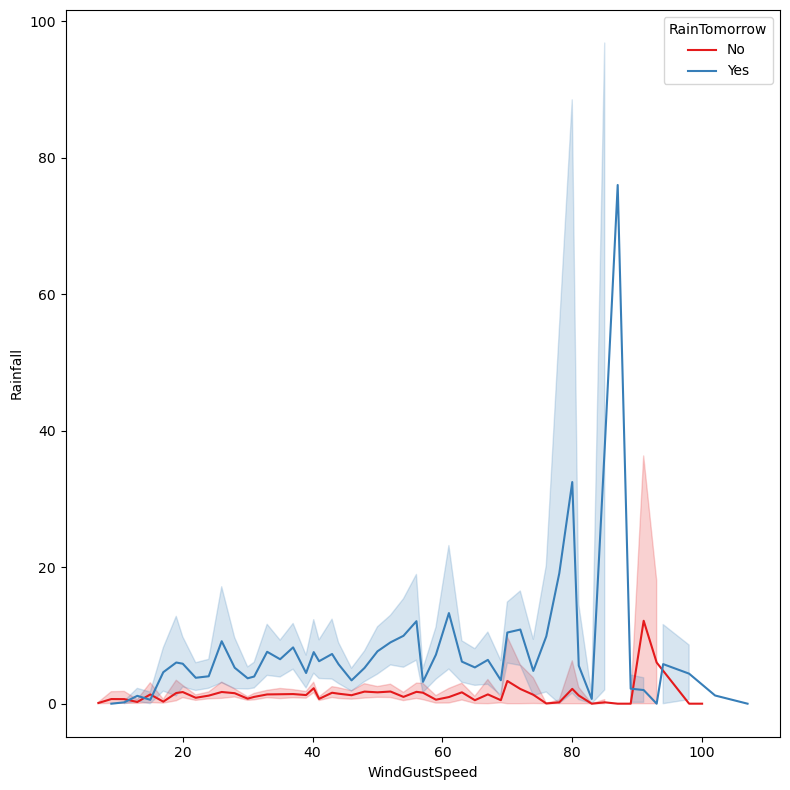

In [43]:
plt.figure (figsize=(8,8))
sns.lineplot(x='WindGustSpeed',y='Rainfall',hue='RainTomorrow',data=data,palette='Set1')
plt.show()

**Observation-:**

- If we have Wind Speed of 80 to 90 there are max chances of rainfall tomorrow.

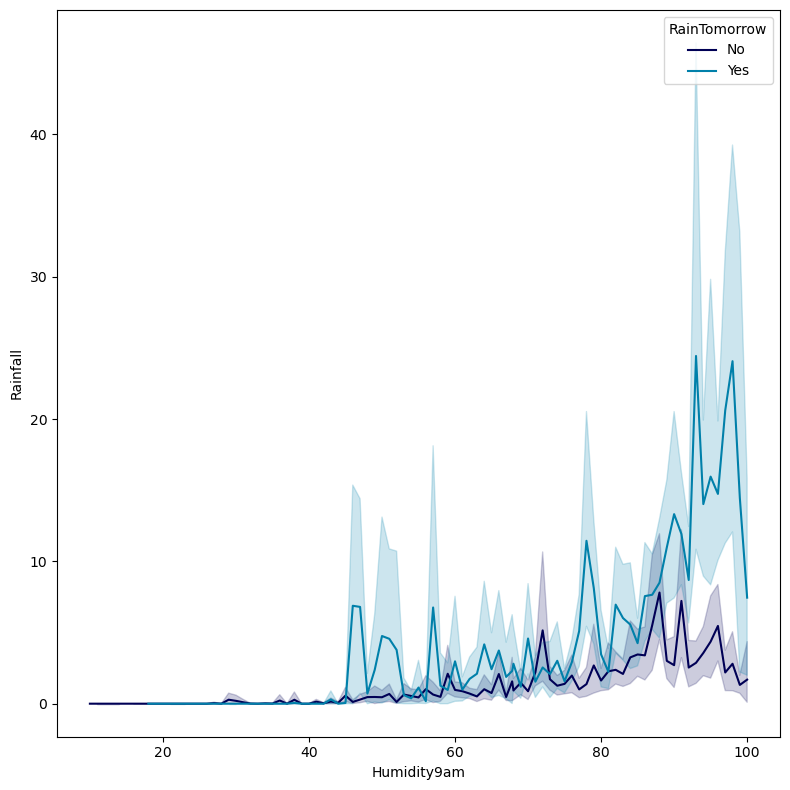

In [44]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Humidity9am',y='Rainfall',hue='RainTomorrow',data=data,palette='ocean')
plt.show()

**Observation-:**

- If we have a humidity of max 83 to 100, there are max possibility of rainfall tomorrow at 9am.

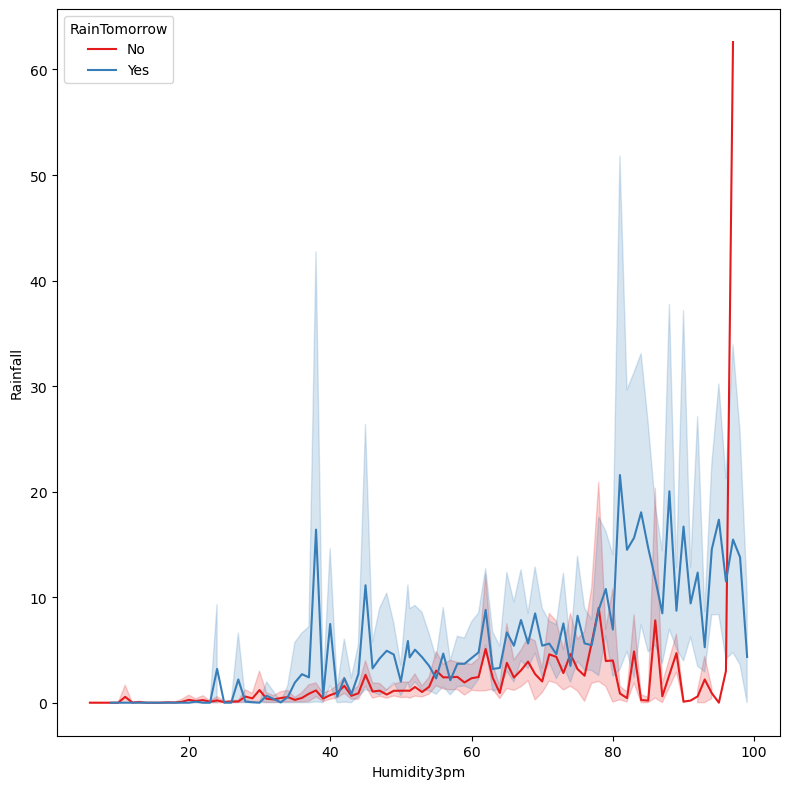

In [45]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Humidity3pm',y='Rainfall',hue='RainTomorrow',data=data,palette='Set1')
plt.show()

**Observation-:**

- It is a Same as 9am. If we have a humidity of max 83 to 100, there are max possibility of rainfall tomorrow at 9am.

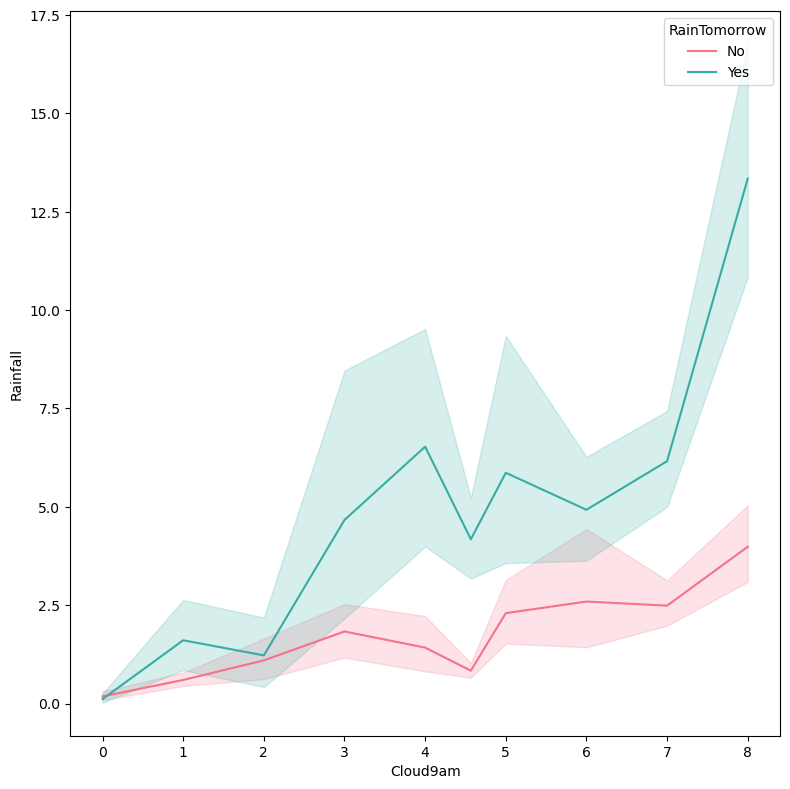

In [46]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Cloud9am',y='Rainfall',hue='RainTomorrow',data=data,palette='husl')
plt.show()

**Observation-:**

- If we have 2-5 Fraction of sky obscured by cloud, there are possibility of rainfall tomorrow at 9am.

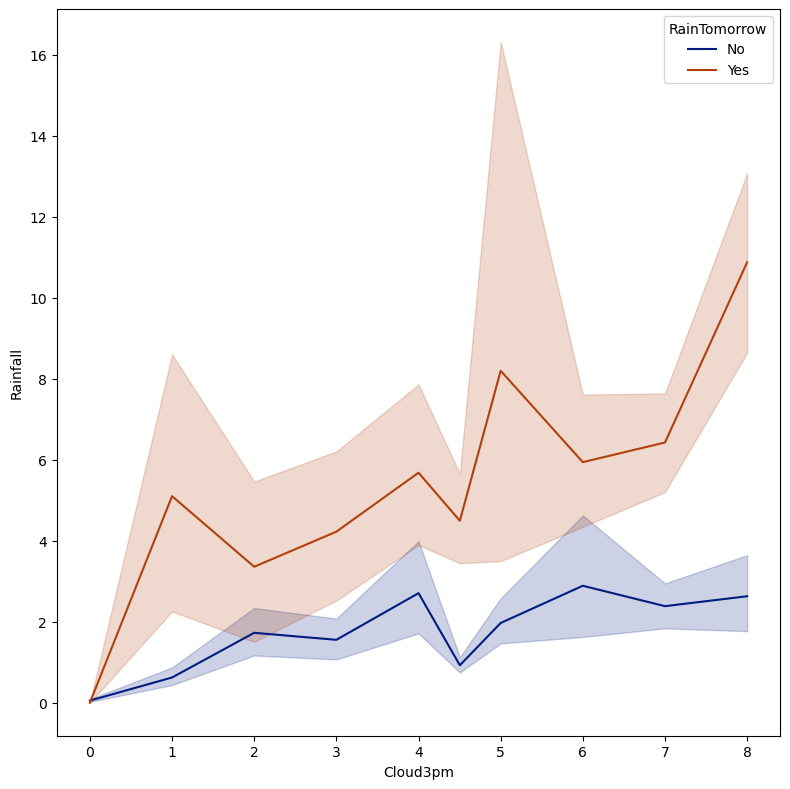

In [47]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Cloud3pm',y='Rainfall',hue='RainTomorrow',data=data,palette='dark')
plt.show()

**Observation-:**

- If we have 2-5 Fraction of sky obscured by cloud, there are possibility of rainfall tomorrow at 9am

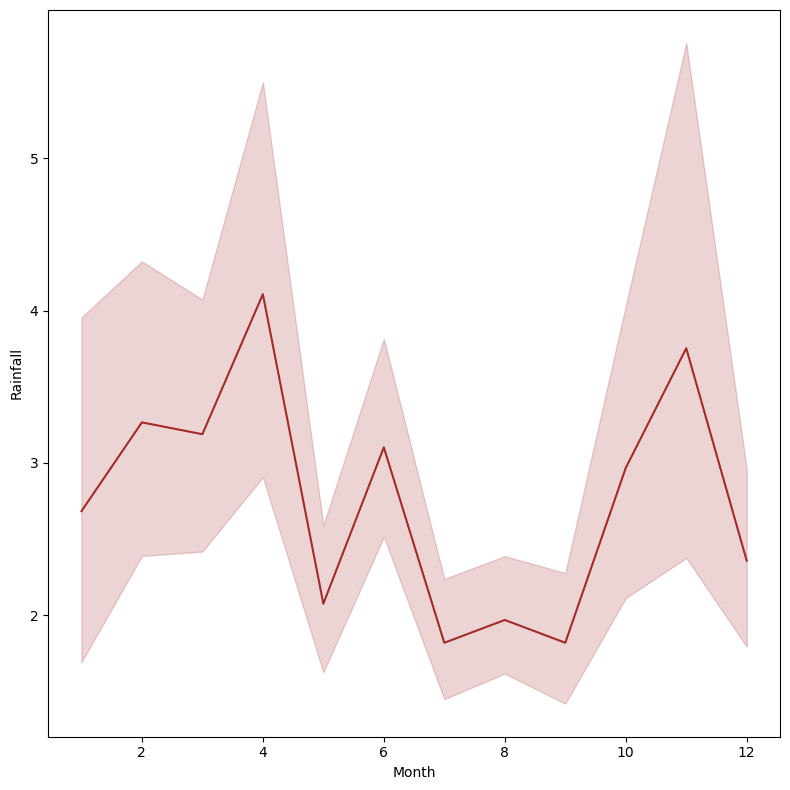

In [48]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Month',y='Rainfall',data=data,palette='dark',color='brown')
plt.show()

**Observation-:**

- We have observed that rainfall in Australia has been taken place in march, april, october and november

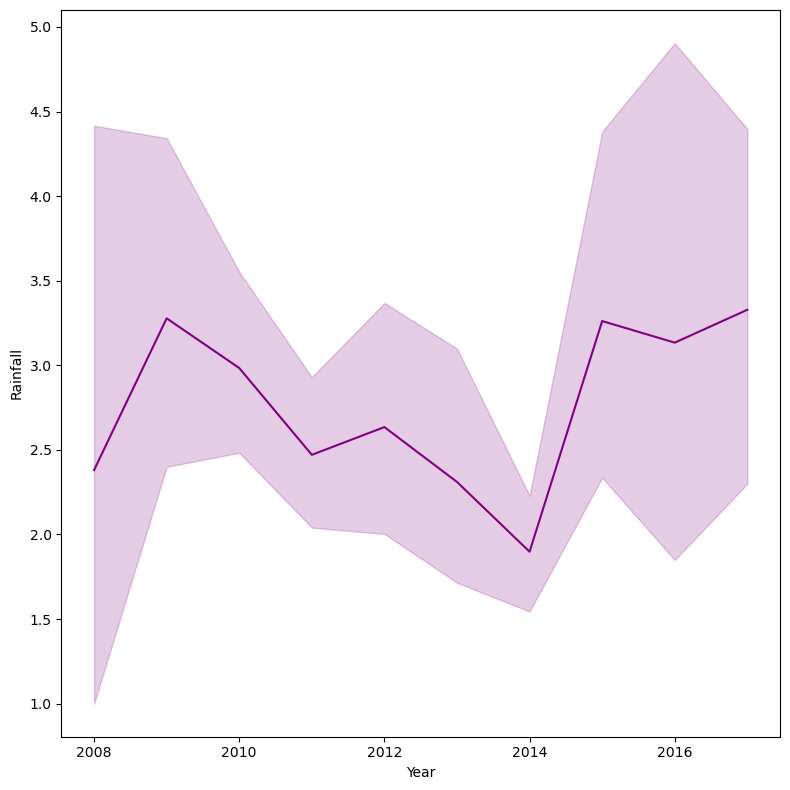

In [49]:
plt.figure (figsize=(8,8))
sns.lineplot(x='Year',y='Rainfall',data=data,palette='plasma',color='purple')
plt.show()

**Observation-:**

- In year 2009 and 2015 maximum rainfall have been taken place above 3mm and 2014 seems to be least

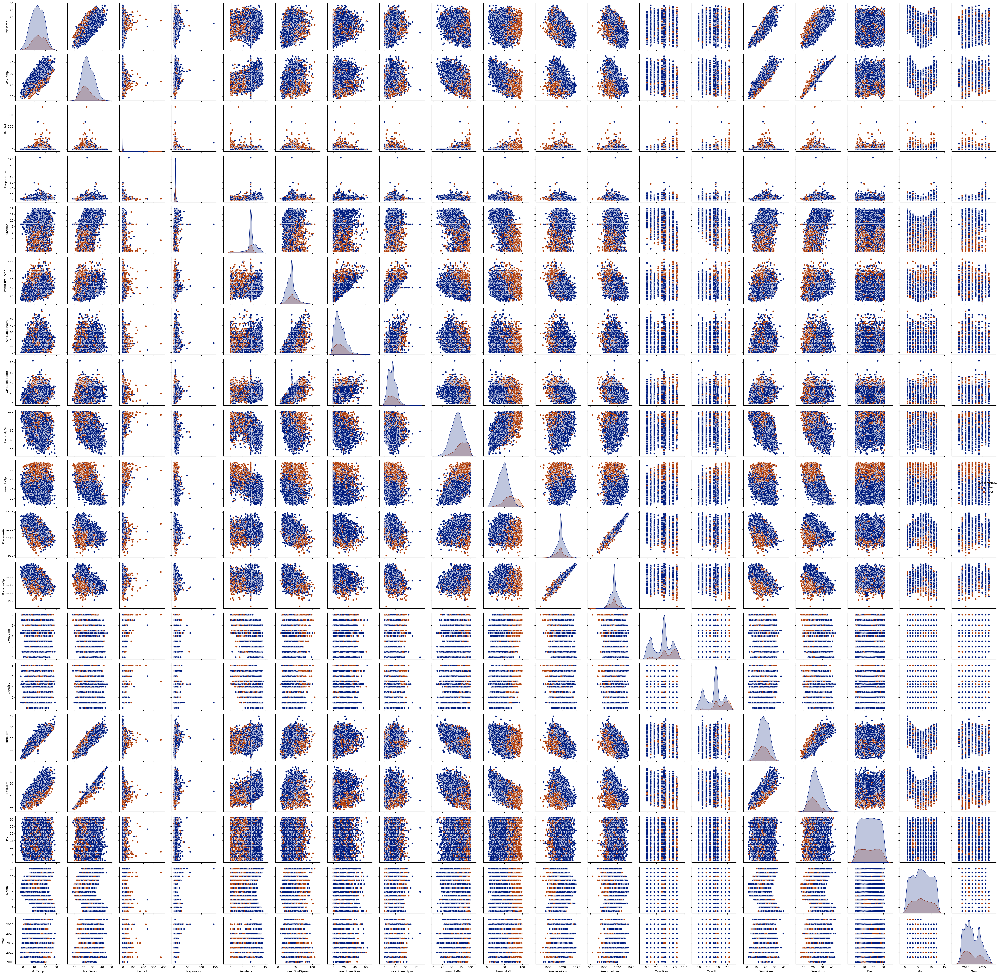

In [50]:
sns.pairplot(data=data,hue='RainTomorrow',palette='dark')

**Observation-:**

- This pairplot gives the pairwise relation between the columns which is plotted on the basic of target variables "Rain Tomorrow". Here we can observ the relation between the feature and lable.

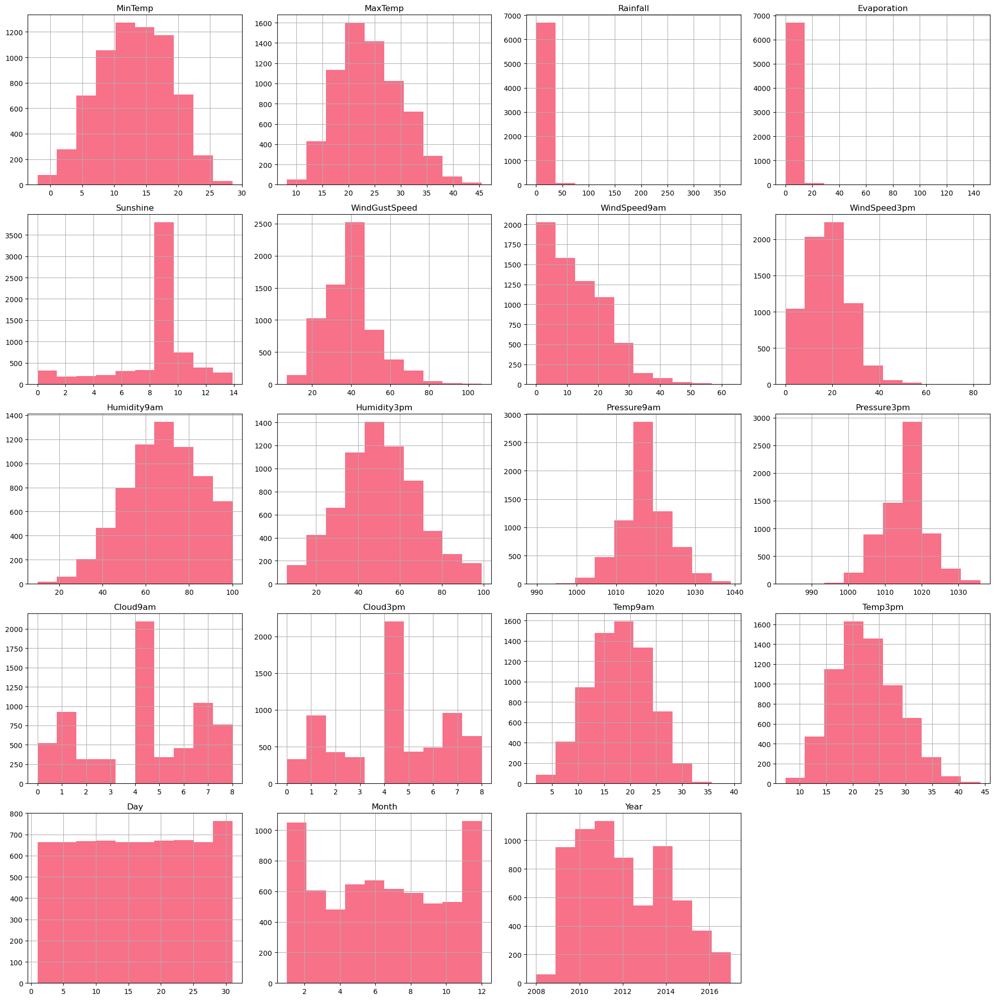

In [51]:
data.hist(bins=10,figsize=(20,20))
plt.show()

# Encoding Categorial Data

In [52]:
Category = ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
for i in Category:
    data[i]=le.fit_transform(data[i])
data.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,0.6,4.6,8.7,13,44.0,13,14,...,1007.1,8.000000,4.503183,16.9,21.8,0,0,1,12,2008
1,1,7.4,25.1,0.0,4.6,8.7,14,44.0,6,15,...,1007.8,4.566622,4.503183,17.2,24.3,0,0,2,12,2008
2,1,12.9,25.7,0.0,4.6,8.7,15,46.0,13,15,...,1008.7,4.566622,2.000000,21.0,23.2,0,0,3,12,2008
3,1,9.2,28.0,0.0,4.6,8.7,4,24.0,9,0,...,1012.8,4.566622,4.503183,18.1,26.5,0,0,4,12,2008
4,1,17.5,32.3,1.0,4.6,8.7,13,41.0,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,12,2008


In [53]:
# we don't need month column so we will drop that column
data.drop("Month",axis=1,inplace=True)

# Feature Selection and Engineering

**Outlier detection and removal**

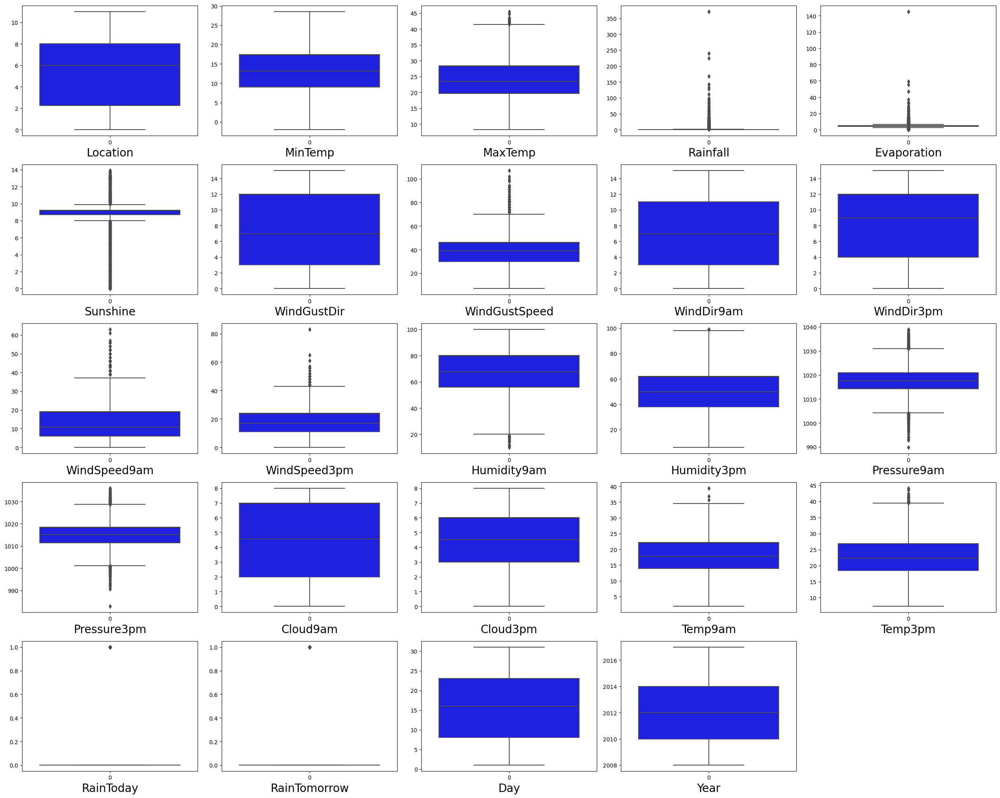

In [54]:
plt.figure(figsize=(25,20), facecolor='white')
plotnumber = 1
for column in data.columns:
    if plotnumber <=25:
        ax = plt.subplot(5,5, plotnumber)
        sns.boxplot(data[column],color='b')
        plt.xlabel(column,fontsize = 20)
    plotnumber+=1
plt.show()

**Z-Score**

In [55]:
fea = data[['MaxTemp','Rainfall','Evaporation','Sunshine','Humidity9am','Humidity3pm','Pressure9am','Pressure3pm','Temp3pm']]
from scipy.stats import zscore
z = np.abs(zscore(fea))
threshold = 3
df = data[(z<3).all(axis = 1)]
print("Shape of the dataframe before removing outliers: ",data.shape)
print("Shape of the dataframe after removing outliers: ",df.shape)




Shape of the dataframe before removing outliers:  (6762, 24)
Shape of the dataframe after removing outliers:  (6532, 24)


**IQR Mehtod**

In [56]:
daa = data.copy()
Q1 =daa.quantile(0.25)
Q3 = daa.quantile(0.75)
IQR= Q3-Q1
print(IQR)

Location          5.75
MinTemp           8.40
MaxTemp           8.80
Rainfall          0.80
Evaporation       1.00
Sunshine          0.50
WindGustDir       9.00
WindGustSpeed    16.00
WindDir9am        8.00
WindDir3pm        8.00
WindSpeed9am     13.00
WindSpeed3pm     13.00
Humidity9am      24.00
Humidity3pm      24.00
Pressure9am       6.70
Pressure3pm       6.90
Cloud9am          5.00
Cloud3pm          3.00
Temp9am           8.30
Temp3pm           8.40
RainToday         0.00
RainTomorrow      0.00
Day              15.00
Year              4.00
dtype: float64


In [57]:
dataa = daa[~((daa < (Q1 - 1.5 * IQR))| (daa > (Q3 + 1.5 * IQR))).any(axis=1)]
print(dataa.shape)

(2093, 24)


In [58]:
data = data.copy()

# Skewness

In [59]:
data.skew()

Location         -0.000009
MinTemp          -0.084774
MaxTemp           0.330804
Rainfall         13.637400
Evaporation      13.603792
Sunshine         -1.265205
WindGustDir       0.181462
WindGustSpeed     0.742028
WindDir9am        0.220355
WindDir3pm       -0.123726
WindSpeed9am      0.953847
WindSpeed3pm      0.545217
Humidity9am      -0.256616
Humidity3pm       0.149053
Pressure9am       0.020745
Pressure3pm       0.031664
Cloud9am         -0.291165
Cloud3pm         -0.227885
Temp9am          -0.046686
Temp3pm           0.349901
RainToday         1.266937
RainTomorrow      1.266937
Day               0.006240
Year              0.354481
dtype: float64

In [60]:
skew = ['Rainfall','Evaporation','Sunshine','WindSpeed9am','WindSpeed3pm']
#import powertransformer
from sklearn.preprocessing import PowerTransformer
scaler= PowerTransformer(method='yeo-johnson')
data[skew] = scaler.fit_transform(data[skew].values)

# Correlation Matrix

In [61]:
data.corr()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Year
Location,1.000000,0.090489,0.070721,0.002191,0.123319,0.073322,-0.074300,0.262774,-0.088884,-0.001275,...,-0.037507,-0.023255,-0.011615,-0.013584,0.098478,0.066192,-0.004280,-0.004506,-0.000710,0.503047
MinTemp,0.090489,1.000000,0.728026,0.076379,0.365746,0.058138,-0.150920,0.242385,-0.021014,-0.139514,...,-0.441335,-0.440895,0.087811,0.040744,0.891378,0.696582,0.075869,0.097202,0.014370,0.033086
MaxTemp,0.070721,0.728026,1.000000,-0.252338,0.463600,0.371209,-0.216905,0.164813,-0.192138,-0.161059,...,-0.337846,-0.413425,-0.246459,-0.243461,0.866664,0.974840,-0.225448,-0.159976,0.016122,0.080913
Rainfall,0.002191,0.076379,-0.252338,1.000000,-0.193663,-0.288373,0.131759,0.082085,0.161015,0.111527,...,-0.117027,-0.040389,0.327578,0.285672,-0.106723,-0.263575,0.939472,0.350152,-0.008204,0.000161
Evaporation,0.123319,0.365746,0.463600,-0.193663,1.000000,0.419181,-0.121471,0.194554,-0.090212,-0.037979,...,-0.266351,-0.285388,-0.116084,-0.159041,0.433382,0.452708,-0.171684,-0.102057,0.009527,0.127421
Sunshine,0.073322,0.058138,0.371209,-0.288373,0.419181,1.000000,-0.124177,0.021073,-0.102186,-0.053668,...,-0.017808,-0.076742,-0.539039,-0.564372,0.252800,0.390207,-0.256810,-0.336376,0.002809,0.076865
WindGustDir,-0.074300,-0.150920,-0.216905,0.131759,-0.121471,-0.124177,1.000000,0.000480,0.385221,0.502140,...,-0.110879,-0.029383,0.121621,0.088311,-0.171100,-0.231060,0.123042,0.048487,0.011975,-0.122957
WindGustSpeed,0.262774,0.242385,0.164813,0.082085,0.194554,0.021073,0.000480,1.000000,-0.075987,0.078794,...,-0.394086,-0.363669,0.007703,0.053480,0.221060,0.129193,0.085796,0.184221,-0.003636,-0.018529
WindDir9am,-0.088884,-0.021014,-0.192138,0.161015,-0.090212,-0.102186,0.385221,-0.075987,1.000000,0.216648,...,-0.027671,0.050710,0.079419,0.058235,-0.070937,-0.200949,0.157884,0.040399,-0.014730,-0.062314
WindDir3pm,-0.001275,-0.139514,-0.161059,0.111527,-0.037979,-0.053668,0.502140,0.078794,0.216648,1.000000,...,-0.139020,-0.049299,0.072567,0.052121,-0.146479,-0.175048,0.094507,0.004301,0.001723,0.010694


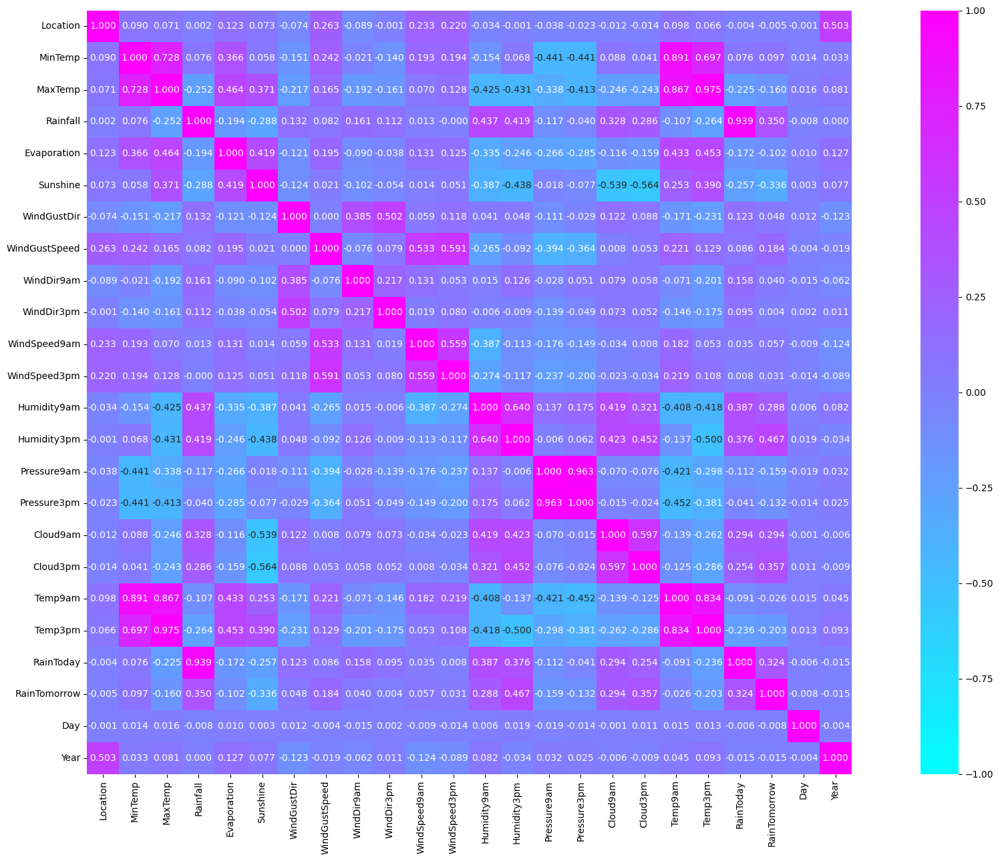

In [62]:
plt.figure(figsize=(21,13))
sns.heatmap(data.corr(),vmin=-1, vmax=1,annot=True, square=True, fmt='0.3f',
           annot_kws={'size':10}, cmap = "cool")
plt.show()

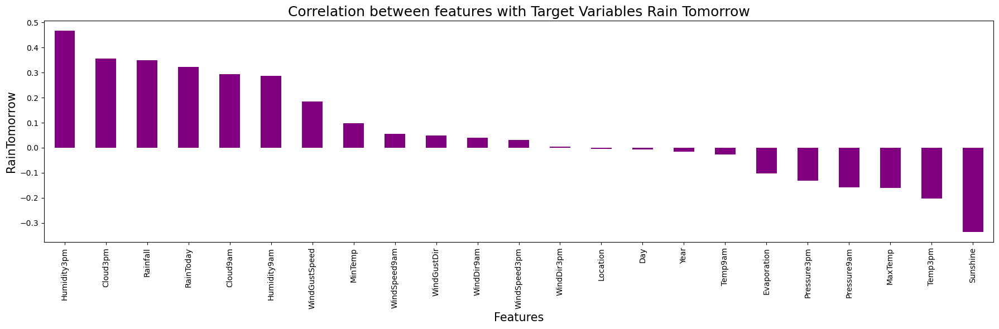

In [63]:
plt.figure(figsize=(18,6))
data.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='purple')
plt.xlabel('Features',fontsize=15)
plt.ylabel('RainTomorrow',fontsize = 15)
plt.title('Correlation between features with Target Variables Rain Tomorrow', fontsize = 18)
plt.show()

# Balancing Imbalanced target Features

In [64]:
data.RainTomorrow.value_counts()

0    5190
1    1572
Name: RainTomorrow, dtype: int64

**As target variable is imbalanced in nature we will need to balance target variable.**

# Balacing using SMOTE

In [65]:
from imblearn.over_sampling import SMOTE

In [66]:
# spliting data in target and dependent features
x = data.drop(['RainTomorrow'],axis = 1)
y = data['RainTomorrow']

In [67]:
# oversampling using SMOTE Techniques
oversample = SMOTE()
x,y = oversample.fit_resample(x,y)

In [68]:
y.value_counts()

0    5190
1    5190
Name: RainTomorrow, dtype: int64

Now, we will resloved all class imbalaced problems and all the categorial have same data ensuring that the ML model does not get biased towords one category

# Standard Scaling

In [69]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_scale = scaler.fit_transform(x)

# Checking Multicollinearity between features using variance_inflation_factor

In [70]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif['VIF']=[variance_inflation_factor(x_scale,i) for i in range(len(x.columns))]
vif['Features']=x.columns
vif

,VIF,Features
0,1.648171,Location
1,9.675266,MinTemp
2,25.193562,MaxTemp
3,4.614604,Rainfall
4,1.563684,Evaporation
5,2.033587,Sunshine
6,1.602995,WindGustDir
7,2.181081,WindGustSpeed
8,1.370782,WindDir9am
9,1.478854,WindDir3pm


# PCA

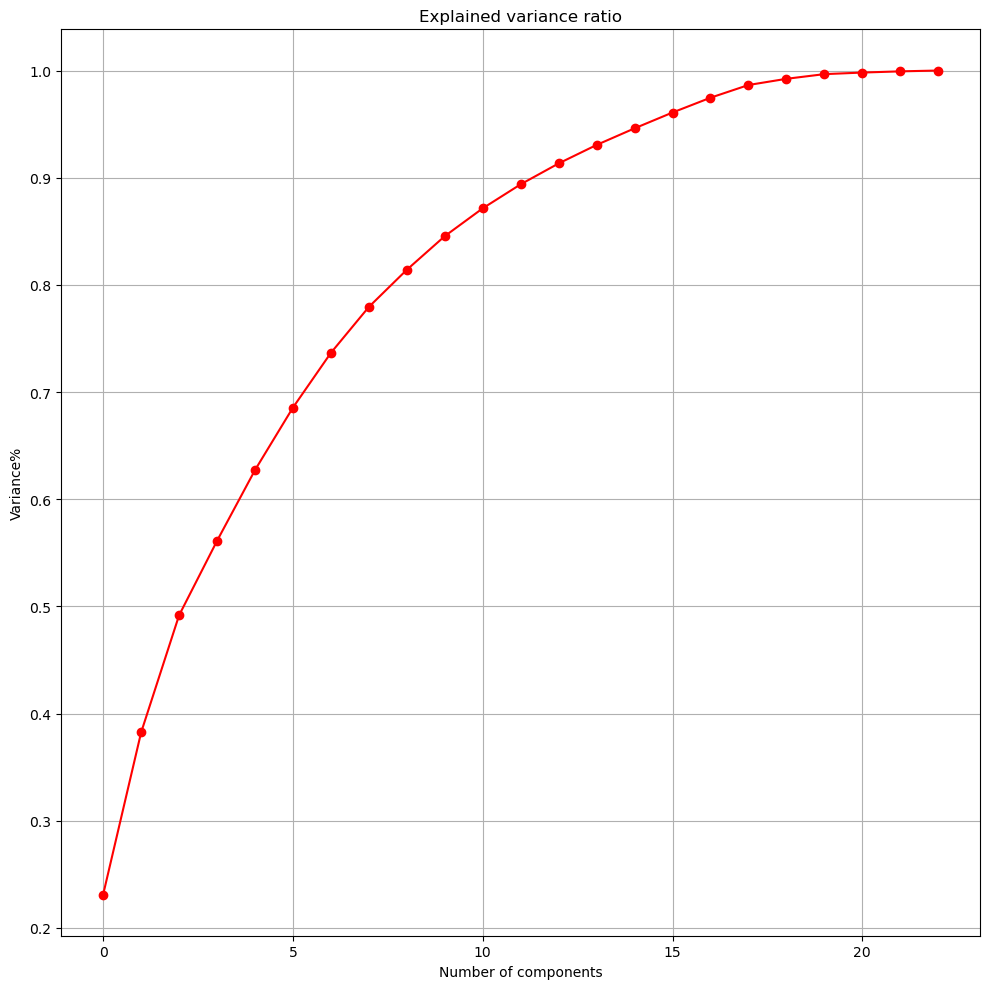

In [71]:
from sklearn.decomposition import PCA
pca = PCA()
# plot the graph to find the principal components
x_pca = pca.fit_transform(x_scale)
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of components')
plt.ylabel('Variance%')
plt.title("Explained variance ratio")
plt.grid()

In [72]:
pca_new = PCA(n_components=12)
x_new = pca_new.fit_transform(x_scale)

In [73]:
pri_x = pd.DataFrame(x_new, columns=np.arange(12))

# Mahine Learning and Model Building

In [74]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier


In [75]:
x_train,x_test,y_train,y_test = train_test_split(pri_x,y,test_size=.3, random_state=99)
print('Training feature matrix size:', x_train.shape)
print('Training target vector :',y_train.shape)
print('Test feature matrix size :',x_test.shape)
print('Test target vector size :', y_test.shape)

Training feature matrix size: (7266, 12)
Training target vector : (7266,)
Test feature matrix size : (3114, 12)
Test target vector size : (3114,)


# Finding Best Random State

In [76]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, f1_score
maxAccu=0
maxRs=0
for i in range (1,250):
    x_train,x_test,y_train,y_test= train_test_split(pri_x,y,test_size = 0.3, random_state=i)
    lr = LogisticRegression()
    lr.fit(x_train,y_train)
    y_pred=lr.predict(x_test)
    acc = accuracy_score(y_test, y_pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Best accuracy is', maxAccu, 'on Random_state',maxRS)

Best accuracy is 0.7832369942196532 on Random_state 246


# Logistic Regression

In [77]:
x_train,x_test,y_train,y_test = train_test_split(pri_x,y,test_size=.3,random_state=9)
lrr = LogisticRegression()
lrr.fit(x_train,y_train)
y_pred = lrr.predict(x_test)
print("Logistic Regression Evaluation")
print('\n')
print("Accuracy Score Of Logistic Regression : ",accuracy_score(y_test,y_pred))
print("Confusion Matrix Of Logistic Regression : ",confusion_matrix(y_test,y_pred))
print("Classification Report Of Logistic Regression : ", classification_report(y_test,y_pred))

Logistic Regression Evaluation


Accuracy Score Of Logistic Regression :  0.7607578676942839
Confusion Matrix Of Logistic Regression :  [[1208  366]
 [ 379 1161]]
Classification Report Of Logistic Regression :                precision    recall  f1-score   support

           0       0.76      0.77      0.76      1574
           1       0.76      0.75      0.76      1540

    accuracy                           0.76      3114
   macro avg       0.76      0.76      0.76      3114
weighted avg       0.76      0.76      0.76      3114



# Cross Validation

In [78]:
from sklearn.model_selection import cross_val_score
cv_score = cross_val_score(lrr, x,y,cv=5)
print("Cross Validation Score",lrr)
print("CVS Score : ", cv_score)
print("Mean CVS Score : ", cv_score.mean())
print("Std Deviation : ",cv_score.std())

Cross Validation Score LogisticRegression()
CVS Score :  [0.67003854 0.72639692 0.64980732 0.76734104 0.84344894]
Mean CVS Score :  0.7314065510597303
Std Deviation :  0.06970559299881143


# Applying Other ML Classification Algorithm

In [79]:
models =[
    SVC(),
    DecisionTreeClassifier(),
    ExtraTreesClassifier(),
    KNeighborsClassifier(),
    RandomForestClassifier(),
    AdaBoostClassifier(),
    GradientBoostingClassifier(),
    BaggingClassifier()]

for m in models:
    m.fit(x_train,y_train)
    y_pred=m.predict(x_test)
    print('\033[1m'+'Classification ML Algorithm Evaluation Matrix',m,'is' + '\033[0m')
    print('\n')
    print('\033[1m'+'Accuracy Score :' + '\033[0m\n',accuracy_score(y_test,y_pred))
    print('\n')
    print('\033[1m'+'Confusion Matrix' + '\033[0m \n',confusion_matrix(y_test,y_pred))
    print('\n')
    print('\033[1m'+'Classification Report' + '\033[0m \n',classification_report(y_test,y_pred))
    print('\n')
    print('===================================================================================================================')

Classification ML Algorithm Evaluation Matrix SVC() is


Accuracy Score :
 0.8159922928709056


Confusion Matrix 
 [[1262  312]
 [ 261 1279]]


Classification Report 
               precision    recall  f1-score   support

           0       0.83      0.80      0.81      1574
           1       0.80      0.83      0.82      1540

    accuracy                           0.82      3114
   macro avg       0.82      0.82      0.82      3114
weighted avg       0.82      0.82      0.82      3114



Classification ML Algorithm Evaluation Matrix DecisionTreeClassifier() is


Accuracy Score :
 0.7687861271676301


Confusion Matrix 
 [[1199  375]
 [ 345 1195]]


Classification Report 
               precision    recall  f1-score   support

           0       0.78      0.76      0.77      1574
           1       0.76      0.78      0.77      1540

    accuracy                           0.77      3114
   macro avg       0.77      0.77      0.77      3114
weighted avg       0.77      0.77      0.77 

# Cross validation

In [80]:
from sklearn.model_selection import cross_val_score
model =[
    SVC(),
    DecisionTreeClassifier(),
    ExtraTreesClassifier(),
    KNeighborsClassifier(n_neighbors=12),
    RandomForestClassifier(),
    AdaBoostClassifier(),
    GradientBoostingClassifier(),
    BaggingClassifier()]
for c in model:
    score = cross_val_score(c,x,y, cv=5)
    print('\n')
    print('\033[1m'+'Cross Validation Score',c,'is' + '\033[0m')
    print("Score",score)
    print("Mean Score :",score.mean())
    print("Std Deviation", score.std())
    print('\n')
    print('=====================================================================================================================')



Cross Validation Score SVC() is
Score [0.72350674 0.69171484 0.69653179 0.79527938 0.84152216]
Mean Score : 0.7497109826589595
Std Deviation 0.058964417292746964




Cross Validation Score DecisionTreeClassifier() is
Score [0.51445087 0.53179191 0.64065511 0.74662813 0.82129094]
Mean Score : 0.6509633911368015
Std Deviation 0.11925350330056468




Cross Validation Score ExtraTreesClassifier() is
Score [0.65317919 0.56358382 0.68978805 0.82466281 0.89258189]
Mean Score : 0.7247591522157996
Std Deviation 0.11871762304041769




Cross Validation Score KNeighborsClassifier(n_neighbors=12) is
Score [0.75433526 0.6194605  0.74084778 0.80828516 0.85067437]
Mean Score : 0.7547206165703276
Std Deviation 0.07818463671929737




Cross Validation Score RandomForestClassifier() is
Score [0.66859345 0.52649326 0.62475915 0.78564547 0.88294798]
Mean Score : 0.6976878612716763
Std Deviation 0.12452351259778081




Cross Validation Score AdaBoostClassifier() is
Score [0.61175337 0.46676301 0.58574181

# Hyper-Parameter Tunning: GridSearchCV-:

In [81]:
from sklearn.model_selection import GridSearchCV

In [82]:
param = [{'n_estimators':[100,200,300,400],
         'criterion':['gini','entropy'],
         'max_depth':[10,20,30],
         'max_features':['auto','log2','sqrt'],
          'min_samples_split':[3,5,8,11]
         }]

In [83]:
gc = GridSearchCV(ExtraTreesClassifier(),param,verbose=10)
gc.fit(x_train,y_train)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits
[CV 1/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 1/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=nan total time=   0.0s
[CV 2/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 2/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=nan total time=   0.0s
[CV 3/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 3/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100;, score=nan total time=   0.0s
[CV 4/5; 1/288] START criterion=gini, max_depth=10, max_features=auto, min_samples_split=3, n_estimators=100
[CV 4/5; 1/288] END criterion=gini, max_depth=10, max_features=auto, min_samples_split

GridSearchCV(estimator=ExtraTreesClassifier(),
             param_grid=[{'criterion': ['gini', 'entropy'],
                          'max_depth': [10, 20, 30],
                          'max_features': ['auto', 'log2', 'sqrt'],
                          'min_samples_split': [3, 5, 8, 11],
                          'n_estimators': [100, 200, 300, 400]}],
             verbose=10)

In [84]:
gc.best_params_

{'criterion': 'gini',
 'max_depth': 30,
 'max_features': 'log2',
 'min_samples_split': 3,
 'n_estimators': 400}

# Final model

In [85]:
final = ExtraTreesClassifier(min_samples_split = 3 ,criterion= 'gini', max_depth = 30 , max_features = 'sqrt', n_estimators = 400)
final.fit(x_train,y_train)
y_pred = final.predict(x_test)
print(" Final Extra Trees Classifier Evaluation")
print('\n')
print("Accuracy Score Of Extra Trees Classifier : ",accuracy_score(y_test,y_pred))

 Final Extra Trees Classifier Evaluation


Accuracy Score Of Extra Trees Classifier :  0.8631984585741811


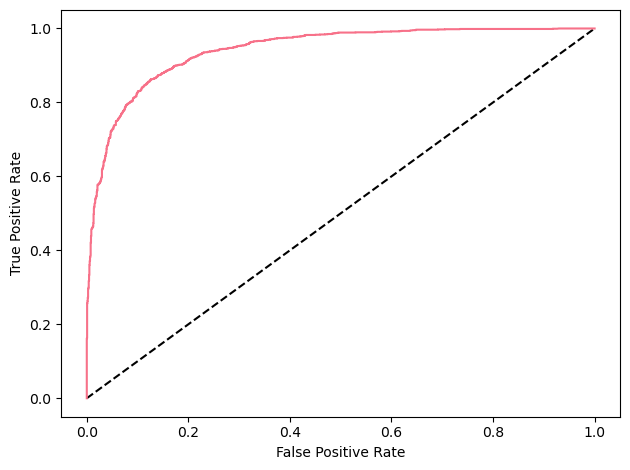

AUC SCORE 0.8634767075364281


In [86]:
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve

y_pred_prob = final.predict_proba(x_test)[:,1]
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr, tpr, label='Random Forest Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.show()
auc_score = roc_auc_score(y_test,final.predict(x_test))
print("AUC SCORE", auc_score)

# Predict the final model

In [87]:
#Prediction
prediction = final.predict(x_test)

In [88]:
Actual = np.array(y_test)
data_pred = pd.DataFrame()
data_pred["Predicted Values"] = prediction
data_pred["Actual Values"] = Actual
data_pred.head()

,Predicted Values,Actual Values
0,0,0
1,1,0
2,0,0
3,1,1
4,1,1


# Saving the model

In [89]:
import joblib
joblib.dump(final,"Rainfall_Tomorrow")

['Rainfall_Tomorrow']

# Classification problem will be predicted well!! Now, we will predict rainfall so we will use regression algorithm for that problem.

In [90]:
data.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Year
0,1,13.4,22.9,0.697862,0.036387,0.030832,13,44.0,13,14,...,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0,0,1,2008
1,1,7.4,25.1,-0.654104,0.036387,0.030832,14,44.0,6,15,...,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0,0,2,2008
2,1,12.9,25.7,-0.654104,0.036387,0.030832,15,46.0,13,15,...,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0,0,3,2008
3,1,9.2,28.0,-0.654104,0.036387,0.030832,4,24.0,9,0,...,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0,0,4,2008
4,1,17.5,32.3,1.060659,0.036387,0.030832,13,41.0,1,7,...,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,2008


# Machine Learning and Model Building

In [92]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso

# Standard Scaling

In [96]:
# Spliting data in target and dependent features
x = data.drop(['Rainfall'],axis=1)
y = data['Rainfall']

In [97]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_scale = scaler.fit_transform(x)

In [98]:
x_train,x_test,y_train,y_test = train_test_split(x_scale,y,test_size=0.33, random_state=557)
print('Training feature matrix size:', x_train.shape)
print('Training target vector :',y_train.shape)
print('Test feature matrix size :',x_test.shape)
print('Test target vector size :', y_test.shape)

Training feature matrix size: (4530, 23)
Training target vector : (4530,)
Test feature matrix size : (2232, 23)
Test target vector size : (2232,)


# Finding best random rate

In [99]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
maxR2_score=0
maxRs=0
for i in range (1,1000):
    x_train,x_test,y_train,y_test= train_test_split(x_scale,y,test_size = .33, random_state=i)
    lr = LinearRegression()
    lr.fit(x_train,y_train)
    y_pred=lr.predict(x_test)
    R2 = r2_score(y_test, y_pred)
    if R2>maxR2_score:
        maxR2_score=R2
        maxRS=i
print('Best accuracy is', maxR2_score, 'on Random_state',maxRS)

Best accuracy is 0.9099930501989362 on Random_state 699


# Linear regression

In [100]:
x_train,x_test,y_train,y_test = train_test_split(x_scale,y,test_size=.3,random_state=91)
lrr = LinearRegression()
lrr.fit(x_train,y_train)
lrr.score(x_train,y_train)
y_pred = lrr.predict(x_test)
print('Predicted result price:\n', y_pred)
print('\n')
print('actual price\n', y_test)

Predicted result price:
 [-0.54318327 -0.39411908  1.67200283 ... -0.60613549 -0.55670505
 -0.61304554]


actual price
 970    -0.007393
877    -0.654104
6734    1.816658
99     -0.654104
7545    1.060659
          ...   
8104   -0.654104
424    -0.654104
944    -0.654104
2691   -0.654104
6936   -0.654104
Name: Rainfall, Length: 2029, dtype: float64


# Applying Other Regressor ML Algorithm

In [101]:
models =[
    SVR(),
    DecisionTreeRegressor(),
    KNeighborsRegressor(),
    RandomForestRegressor(),
    AdaBoostRegressor(),
    GradientBoostingRegressor(),
    XGBRegressor(),
    Ridge(),
    Lasso()]

for m in models:
    m.fit(x_train,y_train)
    y_pred=m.predict(x_test)
    print('\033[1m'+'Errors of ',m,'is' + '\033[0m')
    print('\n')
    print('\033[1m'+'Mean absolute error :' + '\033[0m\n',mean_absolute_error(y_test,y_pred))
    print('\n')
    print('\033[1m'+'Confusion Matrix' + '\033[0m \n',mean_squared_error(y_test,y_pred))
    print('\n')
    print('\033[1m'+'Classification Report' + '\033[0m \n',np.sqrt(mean_squared_error(y_test,y_pred)))
    print('\n')
    print('\033[1m'+'R2 Score' + '\033[0m')
    print(r2_score(y_test,y_pred))
    print('===================================================================================================================')

Errors of  SVR() is


Mean absolute error :
 0.18718739953280833


Confusion Matrix 
 0.10580479480143305


Classification Report 
 0.32527648977667145


R2 Score
0.8951597857513391
Errors of  DecisionTreeRegressor() is


Mean absolute error :
 0.21094579086538853


Confusion Matrix 
 0.19734038006402402


Classification Report 
 0.44423009810685277


R2 Score
0.8044586942902494
Errors of  KNeighborsRegressor() is


Mean absolute error :
 0.22330590110065862


Confusion Matrix 
 0.15853434103350428


Classification Report 
 0.3981637113468583


R2 Score
0.8429109539797742
Errors of  RandomForestRegressor() is


Mean absolute error :
 0.19525538920433066


Confusion Matrix 
 0.10181955259193078


Classification Report 
 0.31909176202454803


R2 Score
0.899108696080603
Errors of  AdaBoostRegressor() is


Mean absolute error :
 0.2708483405125164


Confusion Matrix 
 0.11490446923258321


Classification Report 
 0.33897561746028754


R2 Score
0.8861430694603122
Errors of  GradientBoosting

# Cross Validation

In [103]:
from sklearn.model_selection import cross_val_score
model =[
    SVR(),
    DecisionTreeRegressor(),
    KNeighborsRegressor(),
    RandomForestRegressor(),
    AdaBoostRegressor(),
    GradientBoostingRegressor(),
    XGBRegressor(),
    Ridge(),
    Lasso()]
for c in model:
    score = cross_val_score(c,x,y, cv=5)
    print('\n')
    print('\033[1m'+'Cross Validation Score',c,'is' + '\033[0m')
    print("Score",score)
    print("Mean Score :",score.mean())
    print("Std Deviation", score.std())
    print('\n')
    print('=====================================================================================================================')



Cross Validation Score SVR() is
Score [-0.17545358 -0.27347592 -0.18790301 -0.15543423 -0.10186643]
Mean Score : -0.17882663210215782
Std Deviation 0.055717720629501366




Cross Validation Score DecisionTreeRegressor() is
Score [0.74266827 0.7538472  0.64849492 0.77832778 0.78539697]
Mean Score : 0.7417470264093706
Std Deviation 0.04916642713502006




Cross Validation Score KNeighborsRegressor() is
Score [0.3107687  0.20007905 0.10260337 0.17730049 0.38942086]
Mean Score : 0.23603449316278854
Std Deviation 0.1016453852397038




Cross Validation Score RandomForestRegressor() is
Score [0.89632785 0.86385427 0.85310026 0.89730125 0.89369937]
Mean Score : 0.8808565993199524
Std Deviation 0.018623730657740433




Cross Validation Score AdaBoostRegressor() is
Score [0.87955558 0.85255619 0.8505823  0.88404598 0.87737826]
Mean Score : 0.868823663343709
Std Deviation 0.014265008856597358




Cross Validation Score GradientBoostingRegressor() is
Score [0.90148693 0.86697832 0.87680615 0.90

# Hyper Parameter Tunning: GridSearchCV

In [104]:
from sklearn.model_selection import GridSearchCV

In [105]:
param = [{'n_estimators':[50,60,80],
         'learning_rate':[0.01,0.05,0.1],
         'max_depth':[3,5,7],
          'min_samples_leaf':[1,2,4],
          'min_samples_split':[2,5,10],
          'max_features':["auto","sqrt","log2"]
         }]

In [106]:
gc = GridSearchCV(GradientBoostingRegressor(),param,verbose=5)
gc.fit(x_train,y_train)

Fitting 5 folds for each of 729 candidates, totalling 3645 fits
[CV 1/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=nan total time=   0.0s
[CV 2/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=nan total time=   0.0s
[CV 3/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=nan total time=   0.0s
[CV 4/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=nan total time=   0.0s
[CV 5/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=50;, score=nan total time=   0.0s
[CV 1/5] END learning_rate=0.01, max_depth=3, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=60;, score=nan total time=   0.0s
[CV 2/5] END learn

GridSearchCV(estimator=GradientBoostingRegressor(),
             param_grid=[{'learning_rate': [0.01, 0.05, 0.1],
                          'max_depth': [3, 5, 7],
                          'max_features': ['auto', 'sqrt', 'log2'],
                          'min_samples_leaf': [1, 2, 4],
                          'min_samples_split': [2, 5, 10],
                          'n_estimators': [50, 60, 80]}],
             verbose=5)

In [107]:
gc.best_params_

{'learning_rate': 0.1,
 'max_depth': 3,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 10,
 'n_estimators': 80}

# Final Model

In [108]:
final = GradientBoostingRegressor(n_estimators =80,learning_rate= 0.1, max_depth = 3,max_features = 'sqrt',
                             min_samples_leaf  = 2,min_samples_split=10)
final.fit(x_train,y_train)
y_pred = final.predict(x_test)
print(" Gradient Boosting Regressor Evaluation")
print('\n')
print('Mean absolute error :',mean_absolute_error(y_test,y_pred))
print('Mean Squared error :', mean_squared_error(y_test, y_pred))
print('Root Mean Squared error', np.sqrt(mean_squared_error(y_test,y_pred)))
print('R2_Score',r2_score(y_test,y_pred))

 Gradient Boosting Regressor Evaluation


Mean absolute error : 0.20092640866511635
Mean Squared error : 0.10040034413581354
Root Mean Squared error 0.3168601333961304
R2_Score 0.9005149661733911


# Predict the final model

In [109]:
#Prediction
prediction = final.predict(x_test)

In [110]:
Actual = np.array(y_test)
data_pred = pd.DataFrame()
data_pred["Predicted Values"] = prediction
data_pred["Actual Values"] = Actual
data_pred.head()

,Predicted Values,Actual Values
0,-0.507280,-0.007393
1,-0.356456,-0.654104
2,1.550090,1.816658
3,-0.582511,-0.654104
4,-0.470545,1.060659


# Saving the model

In [111]:
import joblib
joblib.dump(final,"Rainfall")

['Rainfall']